# Comparing scRNAseq normalization methods with TopOMetry

 In this notebook, I'll show how different scRNAseq normalization methods work with TopOMetry and affect the final results. In a nutshell, the T CD4 diversity reported in our manuscript is still present regardless of the normalization method. It's only partially missed when using too few genes (around 500, for instance).
 
To assist us throghout this analysis, we'll be using [scanpy](https://scanpy.readthedocs.io/en/latest/index.html), a scalable toolkit for analyzing single-cell RNA sequencing data. In particular, we'll use the _AnnData_ framework for storing single-cell data and its plotting API for some plotting. _AnnData_ and _scanpy_ are key elements of the python environment for single-cell analysis, and I designed [CellTOMetry](https://github.com/davisidarta/celltometry) to wrap TopOMetry with it in a (hopefully) user-friendly way. Let's start! 

## Install and load libraries

In [1]:
# Install pre-requisites and scanpy (pre-requisites for scanpy are python-igraph and leidenalg)
#!pip install nmslib annoy scipy scanpy numba kneed pymde multicoretsne pacmap trimap ncvis python-igraph leidenalg scanpy 

In [2]:
# Install TopOMetry
#!pip install topometry

In [3]:
import numpy as np
import scanpy as sc
import topo as tp
import celltometry as ct
import matplotlib
import matplotlib.pyplot as plt
matplotlib.use('TkAgg')
%matplotlib inline

/home/davi/.local/lib/python3.9/site-packages/torchvision/io/image.py:11: UserWarning: Failed to load image Python extension: /home/davi/.local/lib/python3.9/site-packages/torchvision/image.so: undefined symbol: _ZNK3c106IValue23reportToTensorTypeErrorEv
  warn(f"Failed to load image Python extension: {e}")


In [4]:
sc.settings.verbosity = 0  
sc.settings.set_figure_params(dpi=100, facecolor='white')
sc.settings.n_jobs = 10

In [5]:
wd = '/home/davi/Bioinfo/TopOMetry_Paper/'

## Load data and QC

Download data from 10X genomics [website](https://cf.10xgenomics.com/samples/cell-exp/1.1.0/fresh_68k_pbmc_donor_a/fresh_68k_pbmc_donor_a_filtered_gene_bc_matrices.tar.gz):

In [6]:
#!mkdir data
#!wget https://cf.10xgenomics.com/samples/cell-exp/1.1.0/fresh_68k_pbmc_donor_a/fresh_68k_pbmc_donor_a_filtered_gene_bc_matrices.tar.gz -O data/fresh_68k_pbmc_donor_a_filtered_gene_bc_matrices.tar.gz
#!cd data; tar -xzf fresh_68k_pbmc_donor_a_filtered_gene_bc_matrices.tar.gz

In [7]:
adata = sc.read_10x_mtx( wd + 
    'data/filtered_matrices_mex/hg19/',  
    var_names='gene_symbols',               
    cache=True)          
adata.var_names_make_unique()
adata                    

AnnData object with n_obs × n_vars = 68579 × 32738
    var: 'gene_ids'

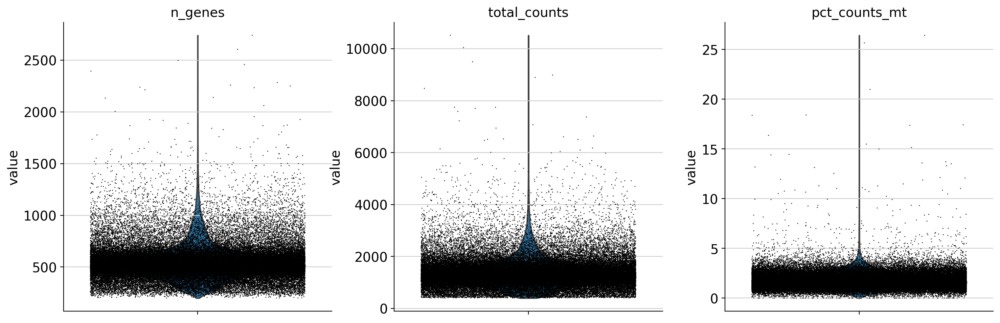

In [8]:
# Default QC
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata, ['n_genes', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

This data contains 6,437 cells with 36,601 sequenced genes each. A great deal of this is just experimental noise, so we need to perform some quality control. Here, we'll do the default quality-control analysis:

In [9]:
adata = adata[adata.obs.n_genes < 1000, :]
adata = adata[adata.obs.total_counts < 4000, :]
adata = adata[adata.obs.pct_counts_mt < 5, :]
adata

View of AnnData object with n_obs × n_vars = 66834 × 17788
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

## Compare different normalization methods 

We'll compare how different methods perform using different numbers of highly-variable genes: 500, 1000 and 2000 marker genes.

In [10]:
adata_raw = adata.copy()

### No normalization at all (count data)

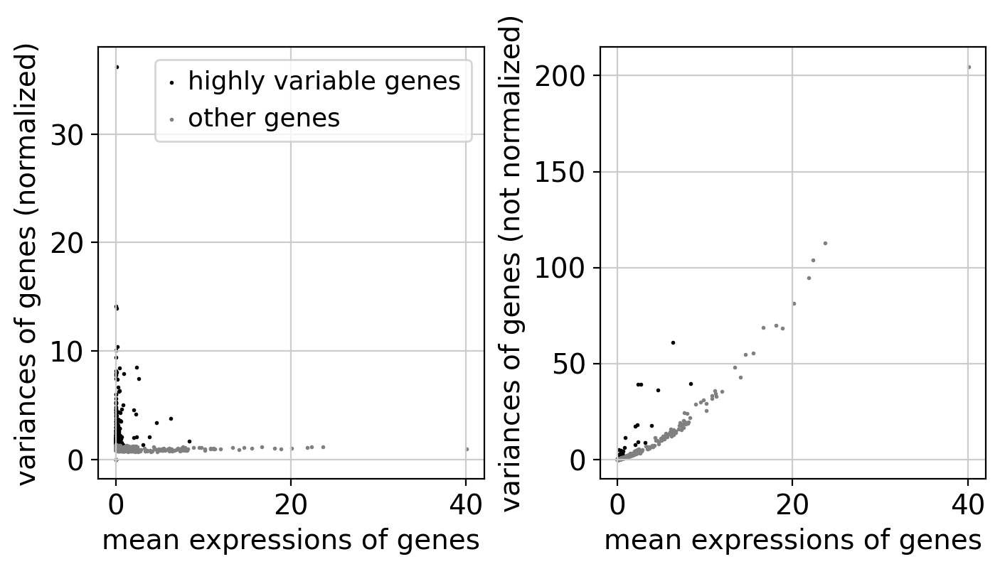

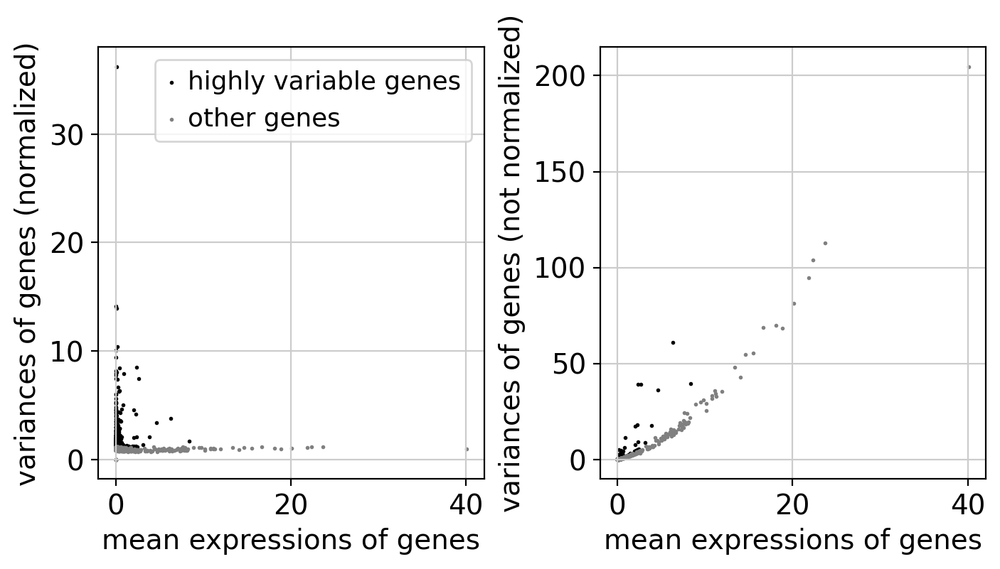

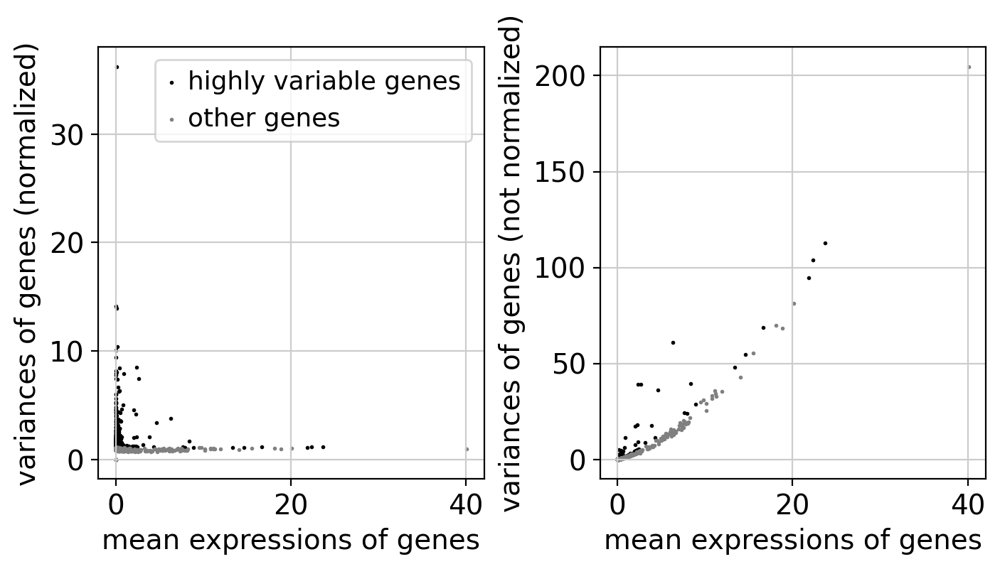

In [11]:
adata_counts_500 = adata_raw.copy()
adata_counts_1k = adata_raw.copy()
adata_counts_2k = adata_raw.copy()

adatas_counts_genes = [(adata_counts_500, 500), (adata_counts_1k, 1000), (adata_counts_2k, 2000)]
adatas_counts = []

# Only the 'seurat_v3' flavor expects raw, unnormalized count data
for adat, n_genes in adatas_counts_genes:
    sc.pp.highly_variable_genes(adat, flavor='seurat_v3', n_top_genes=n_genes)
    sc.pl.highly_variable_genes(adat)
    adat.raw = adat
    adat = adat[:, adat.var.highly_variable]
    adatas_counts.append(adat)

/home/davi/.local/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


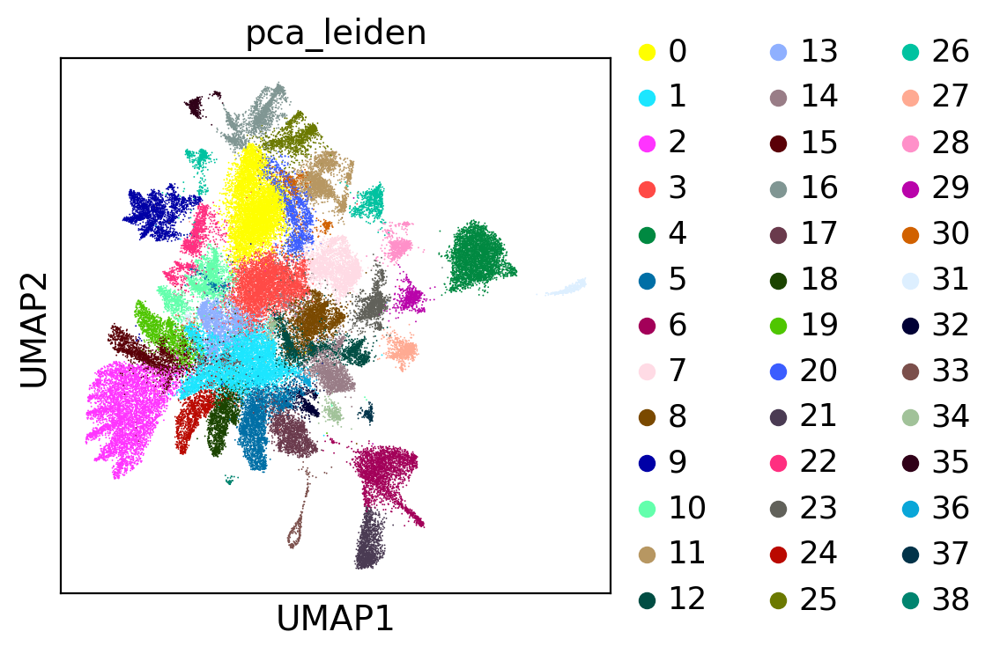

/home/davi/.local/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


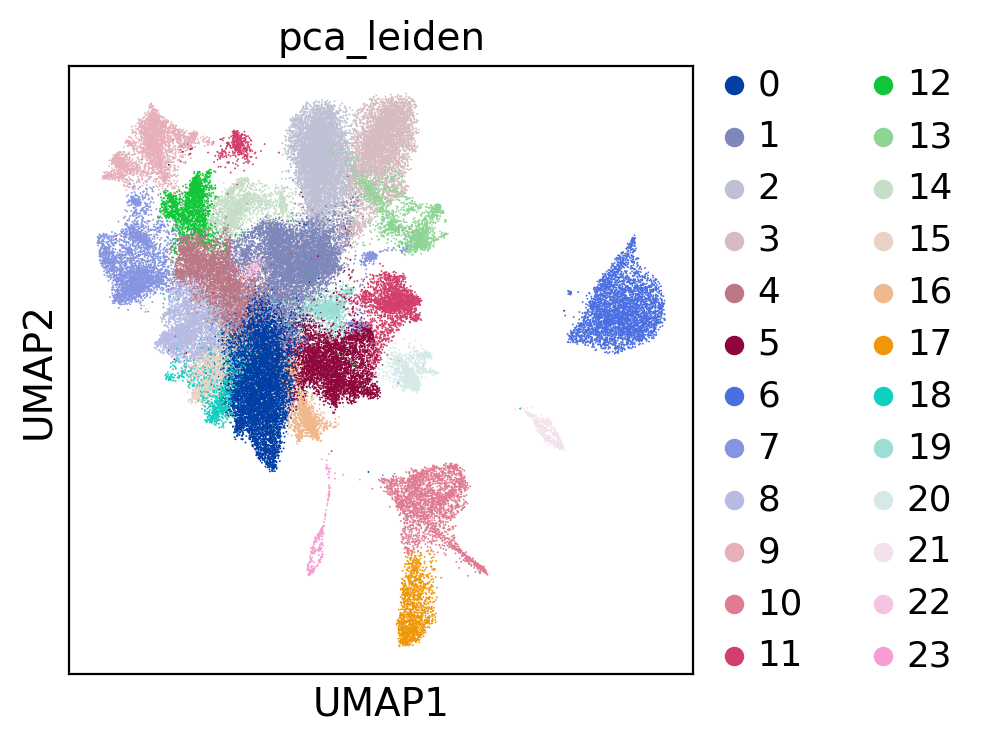

/home/davi/.local/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


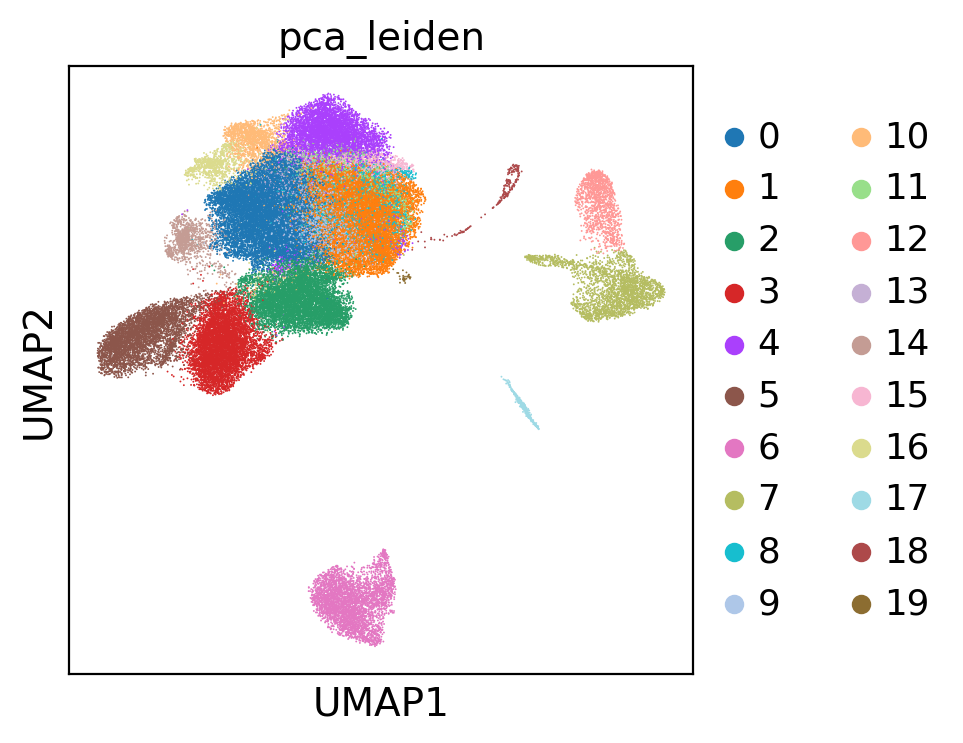

In [12]:
for adat in adatas_counts:
    adat = ct.default_workflow(adat)
    sc.pl.umap(adat, color='pca_leiden')

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


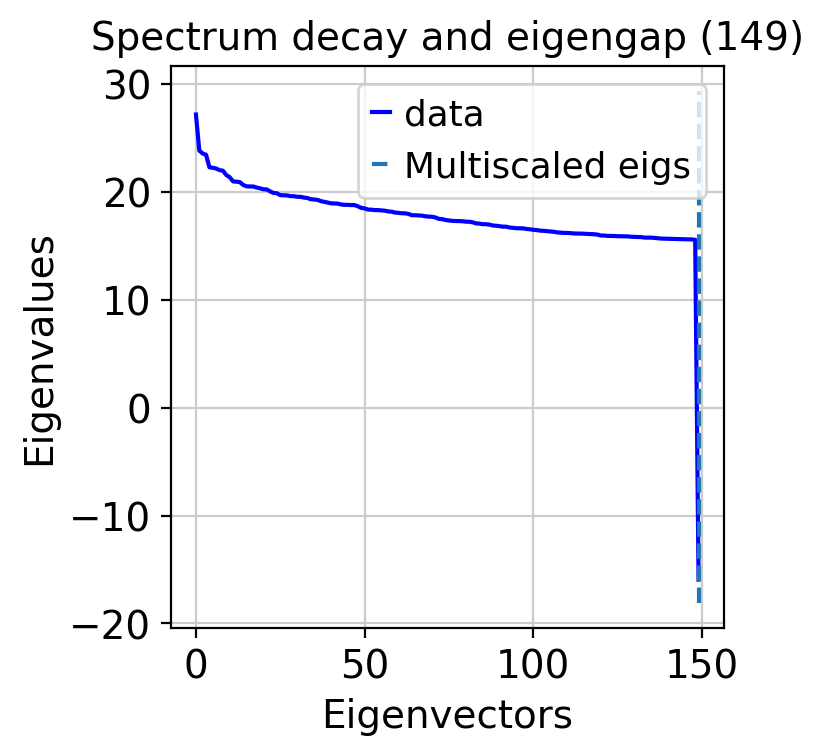

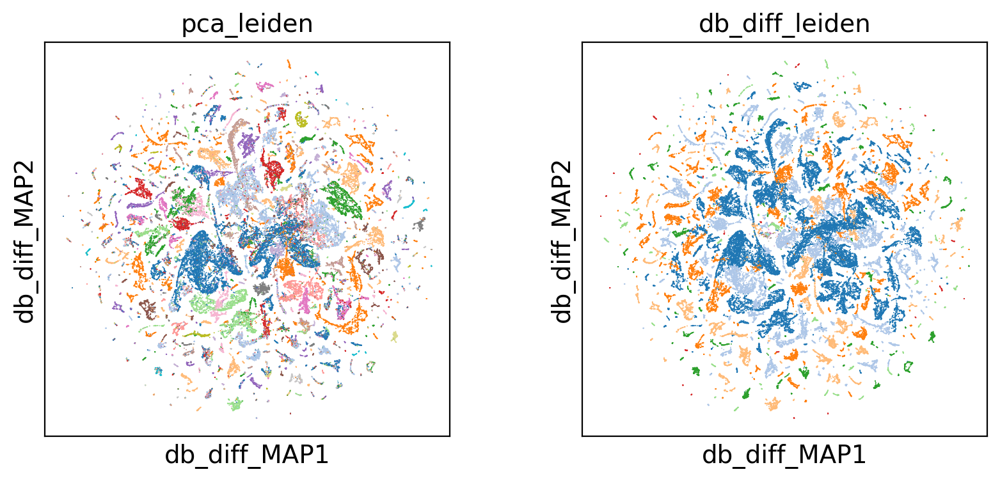

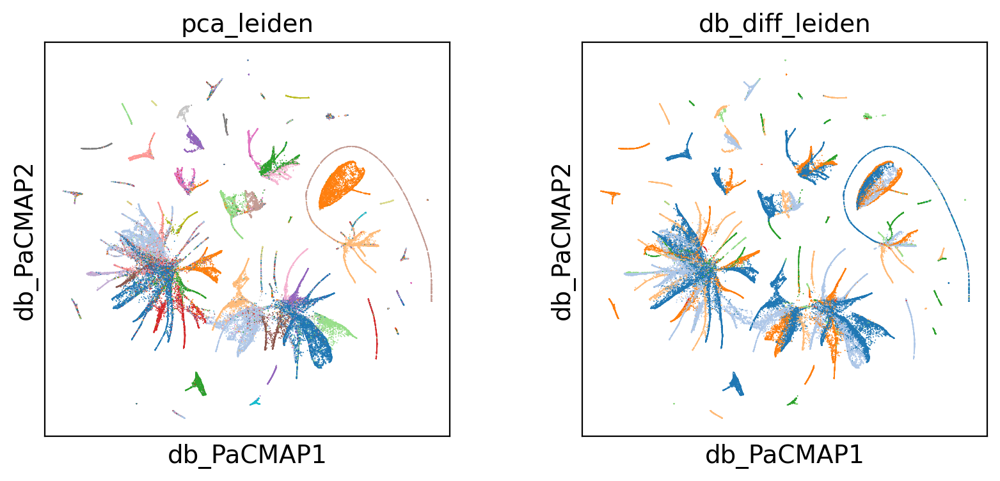

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


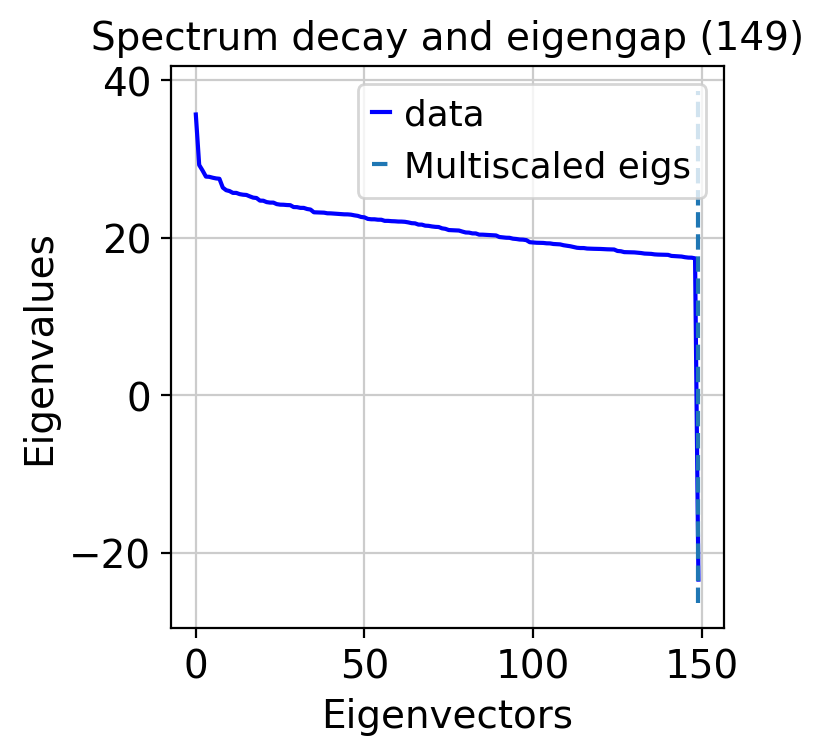

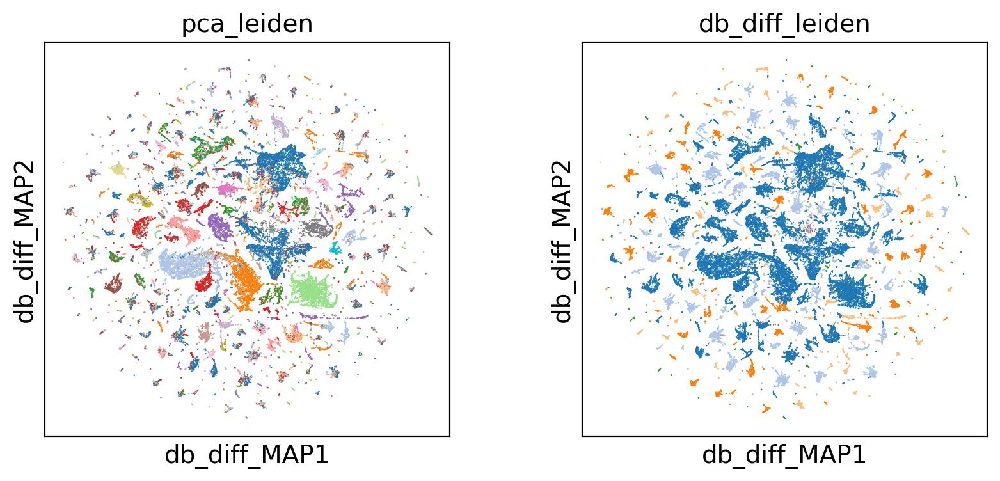

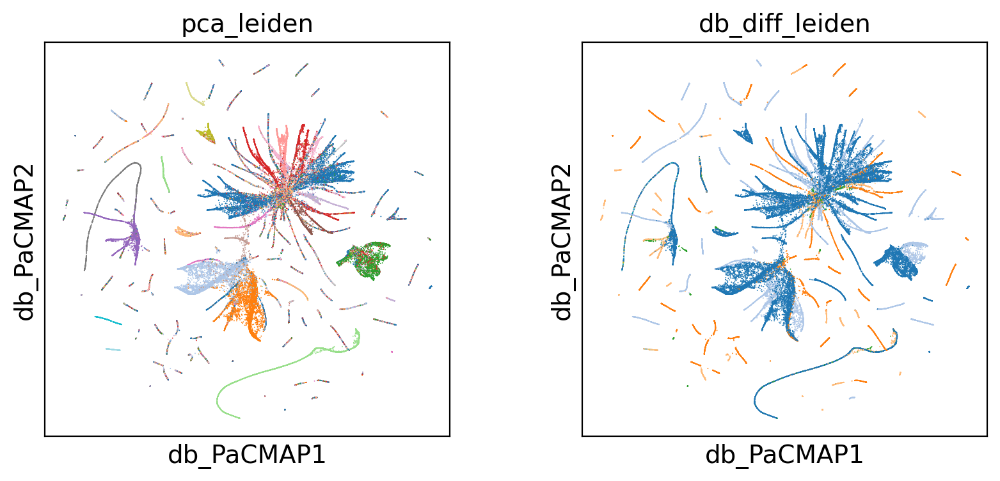

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


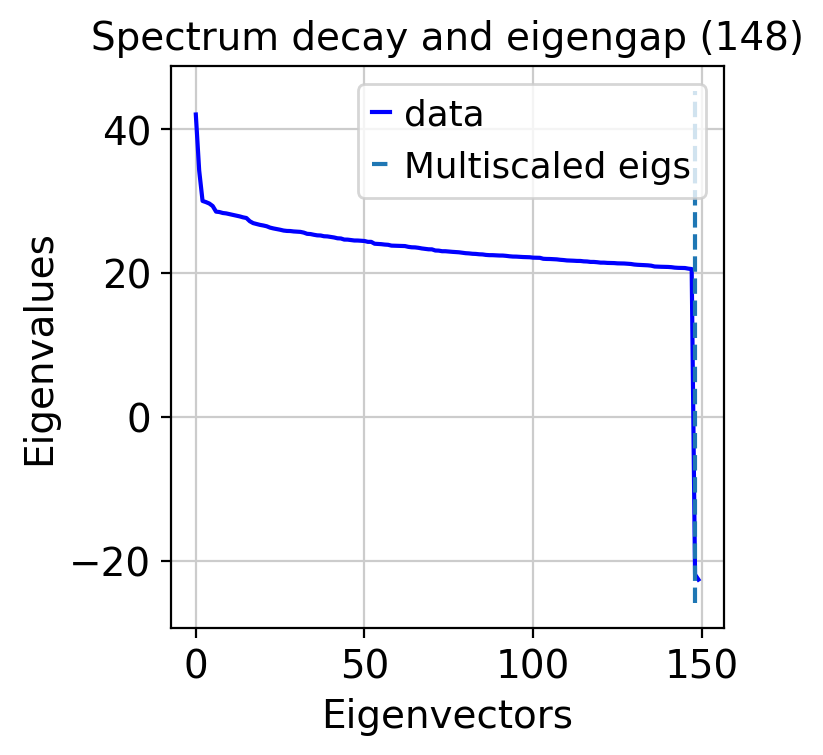

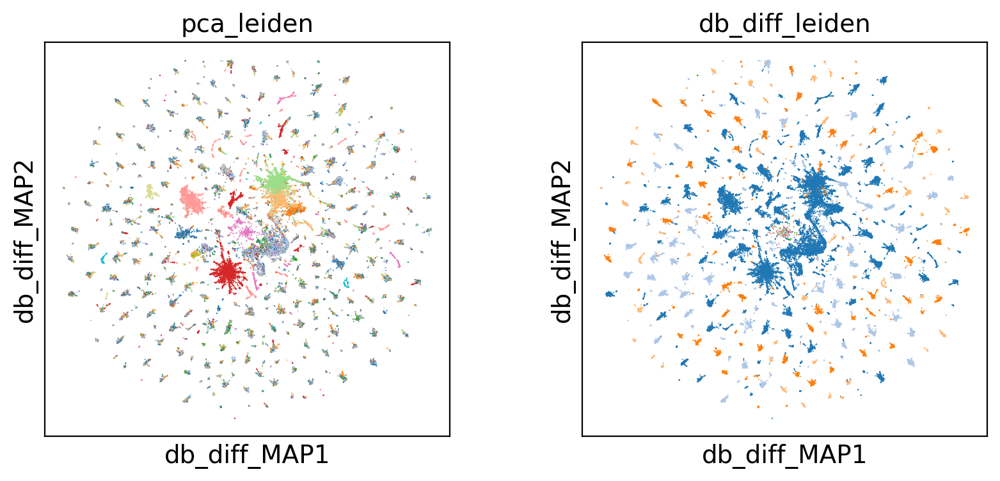

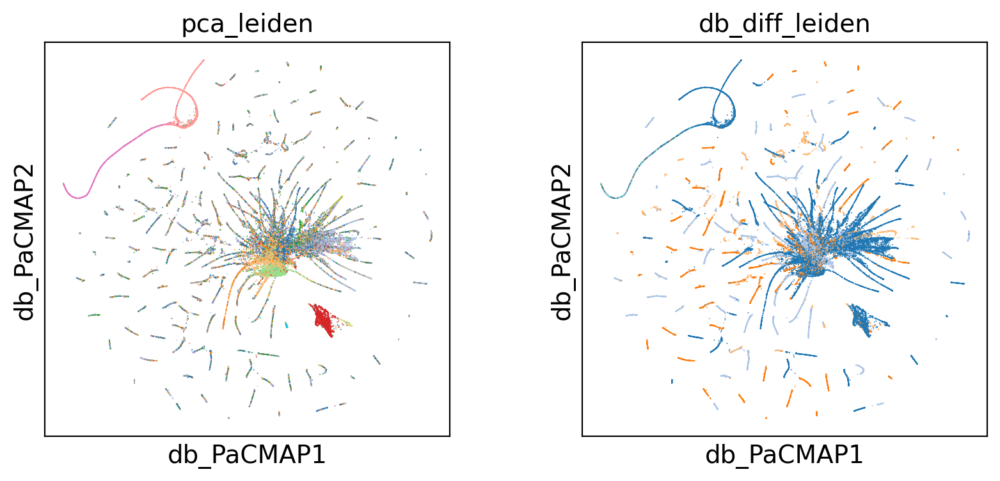

In [13]:
for adat in adatas_counts:
    tg = ct.TopOGraph(n_jobs=12, n_eigs=150, verbosity=0)
    adat = ct.topological_workflow(adat, tg, bases=['diffusion'], 
                                graphs=['diff'],                      
                                layouts=['MAP', 'PaCMAP'])
    tg.eigenspectrum()
    sc.pl.embedding(adat, basis='db_diff_MAP', color=['pca_leiden', 'db_diff_leiden'], palette='tab20', legend_loc=None)
    sc.pl.embedding(adat, basis='db_PaCMAP', color=['pca_leiden', 'db_diff_leiden'], palette='tab20', legend_loc=None)
    

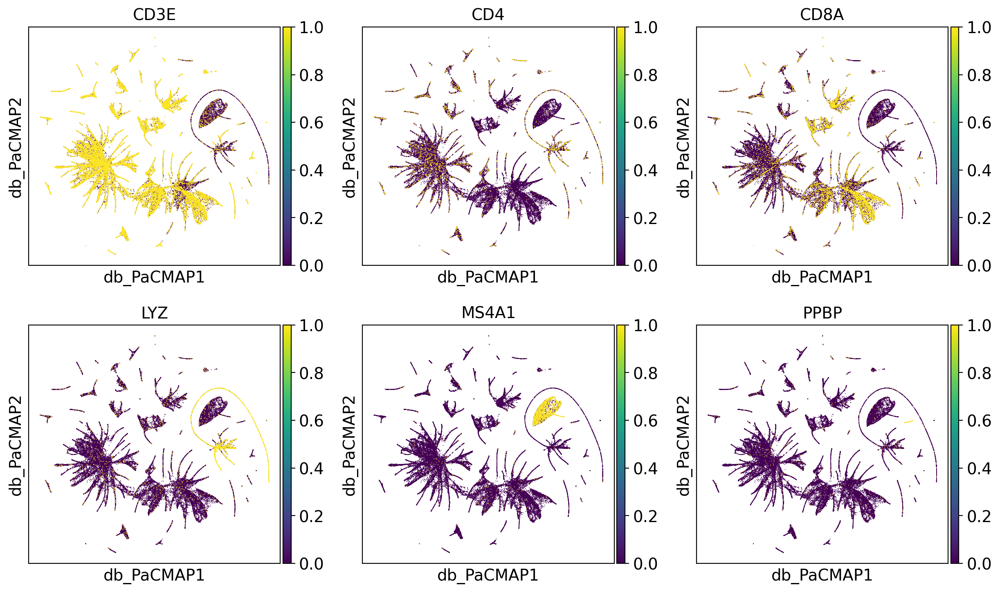

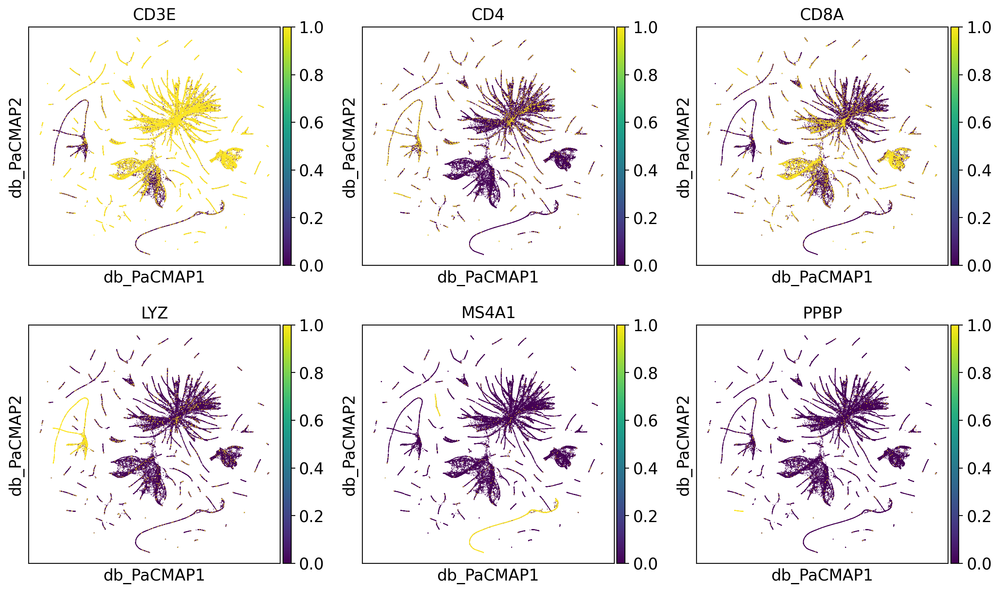

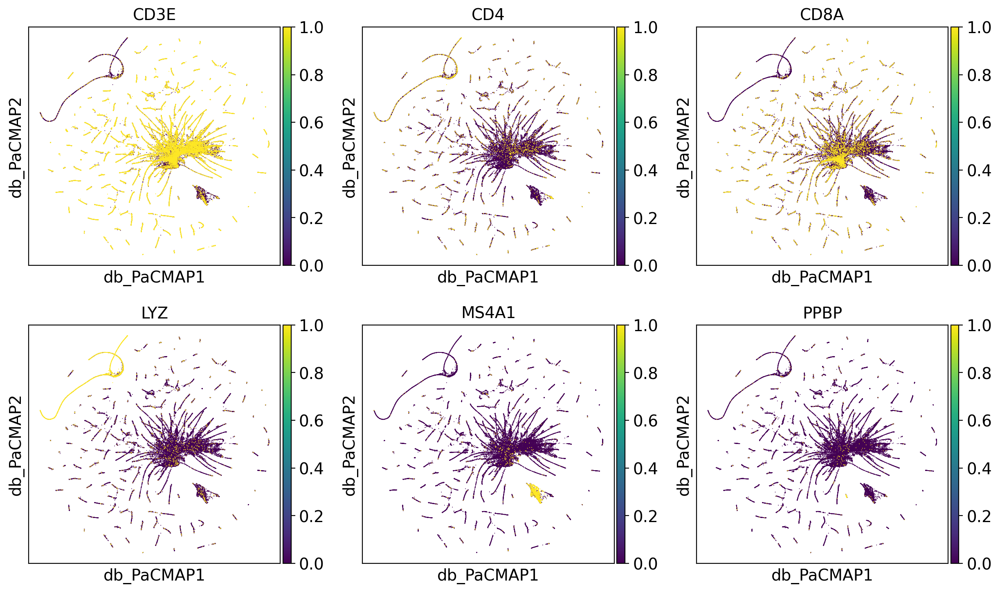

In [14]:
for adat in adatas_counts:
    sc.pl.embedding(adat, basis='db_PaCMAP', color=['CD3E', 'CD4', 'CD8A', 'LYZ', 'MS4A1', 'PPBP'], vmin=0, vmax=1, palette='tab20', legend_loc=None, ncols=3)


### Default Scanpy workflow (depth-normalization and variance stabilization by log)

In [15]:
adata_norm = adata_raw.copy()

In [16]:
sc.pp.normalize_total(adata_norm, target_sum=1e4)
sc.pp.log1p(adata_norm)
adata_norm

AnnData object with n_obs × n_vars = 66834 × 17788
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'

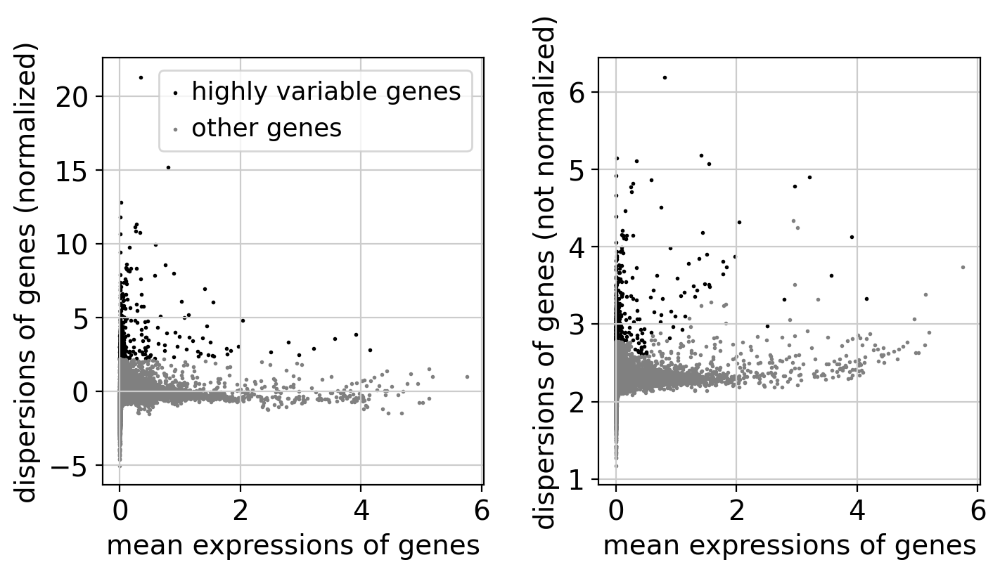

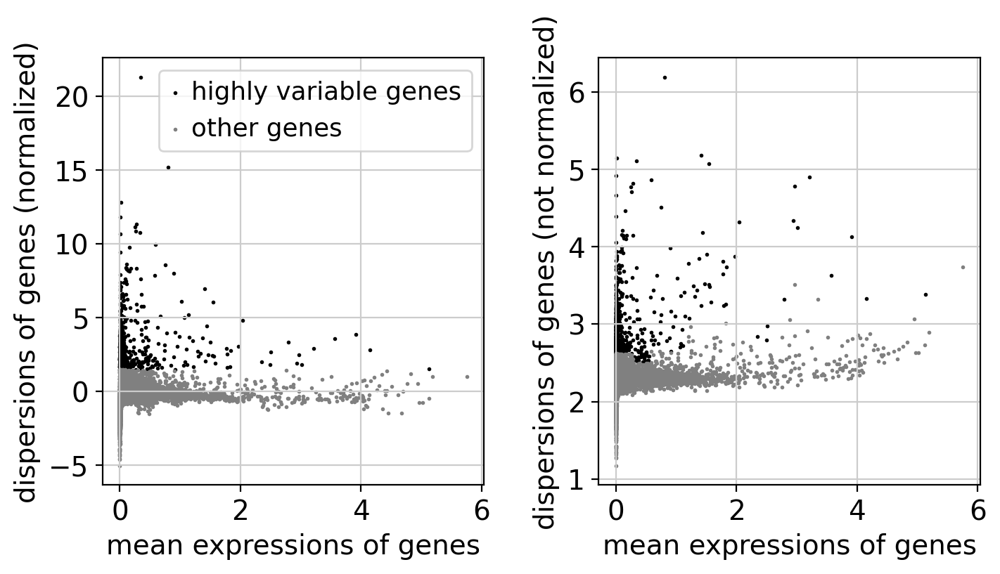

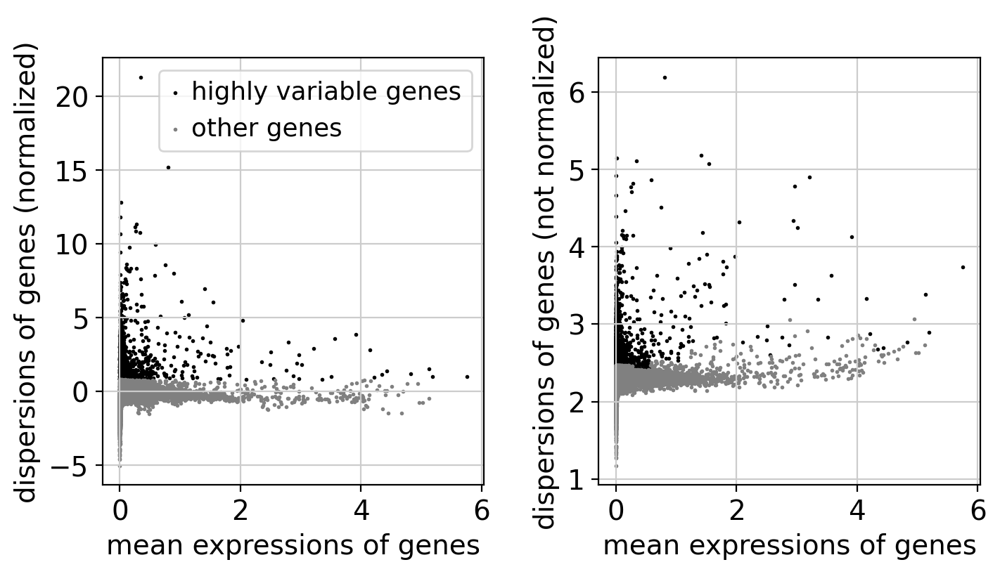

In [17]:
adata_sc_500 = adata_norm.copy()
adata_sc_1k = adata_norm.copy()
adata_sc_2k = adata_norm.copy()

adatas_sc_genes = [(adata_sc_500, 500), (adata_sc_1k, 1000), (adata_sc_2k, 2000)]
adatas_sc = []

for adat, n_genes in adatas_sc_genes:
    sc.pp.highly_variable_genes(adat, n_top_genes=n_genes)
    sc.pl.highly_variable_genes(adat)
    adat.raw = adat
    adat = adat[:, adat.var.highly_variable]
    adatas_sc.append(adat)

/home/davi/.local/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


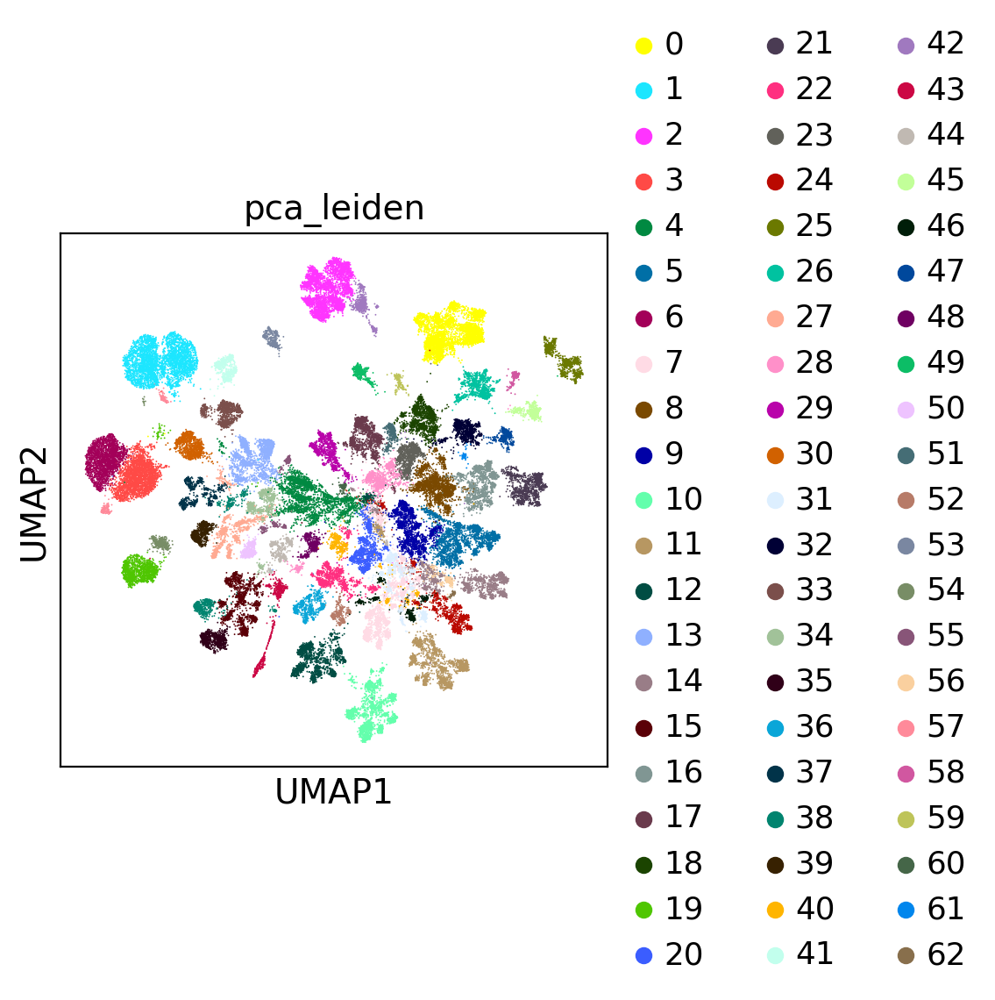

/home/davi/.local/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


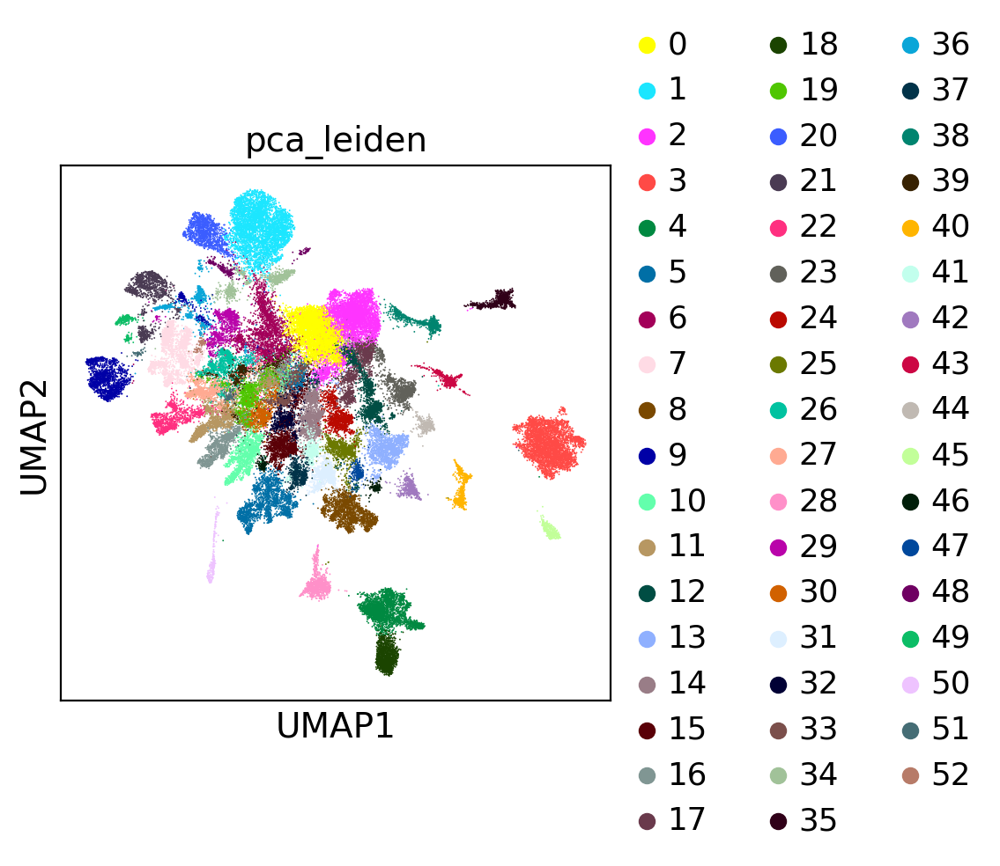

/home/davi/.local/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


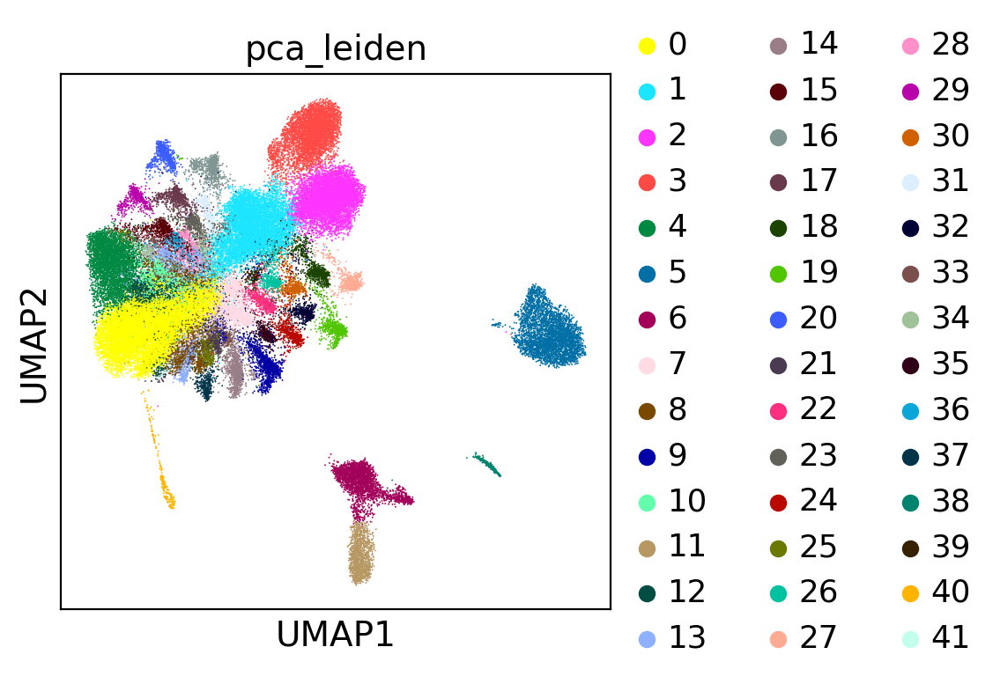

In [18]:
for adat in adatas_sc:
    adat = ct.default_workflow(adat)
    sc.pl.umap(adat, color='pca_leiden')

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


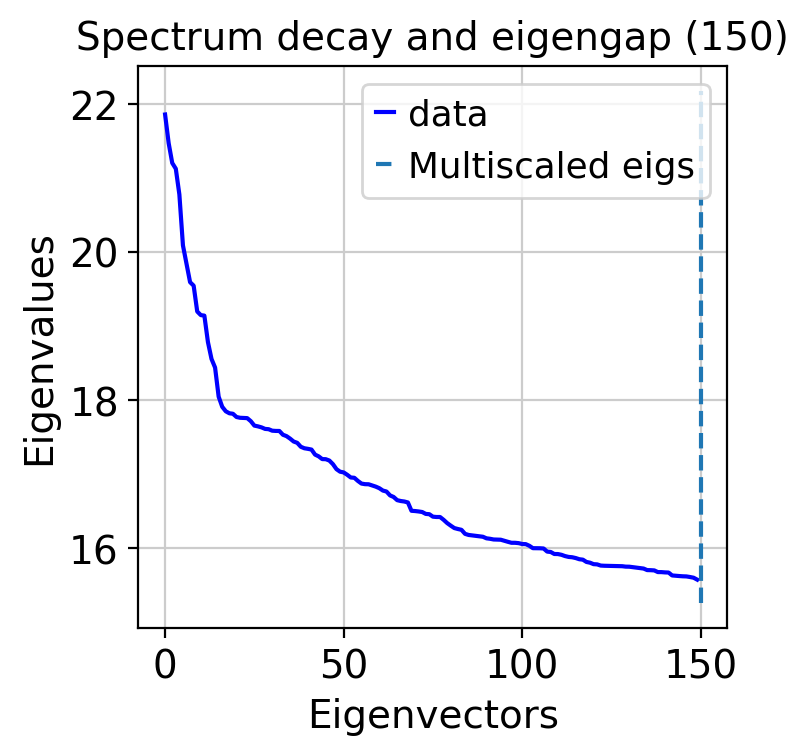

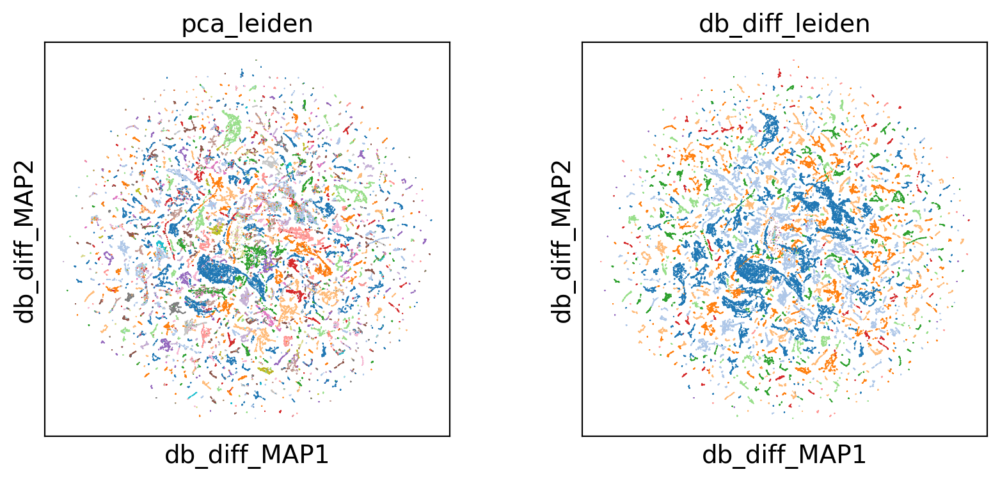

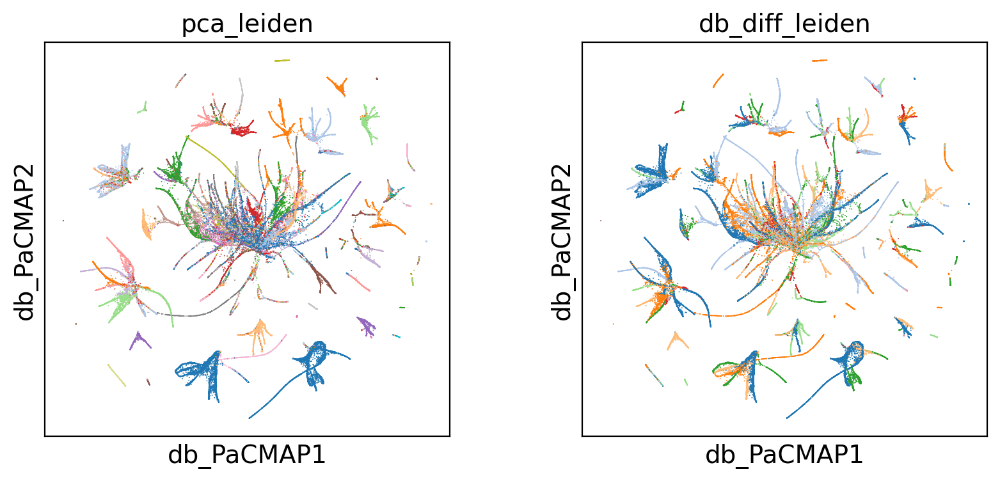

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


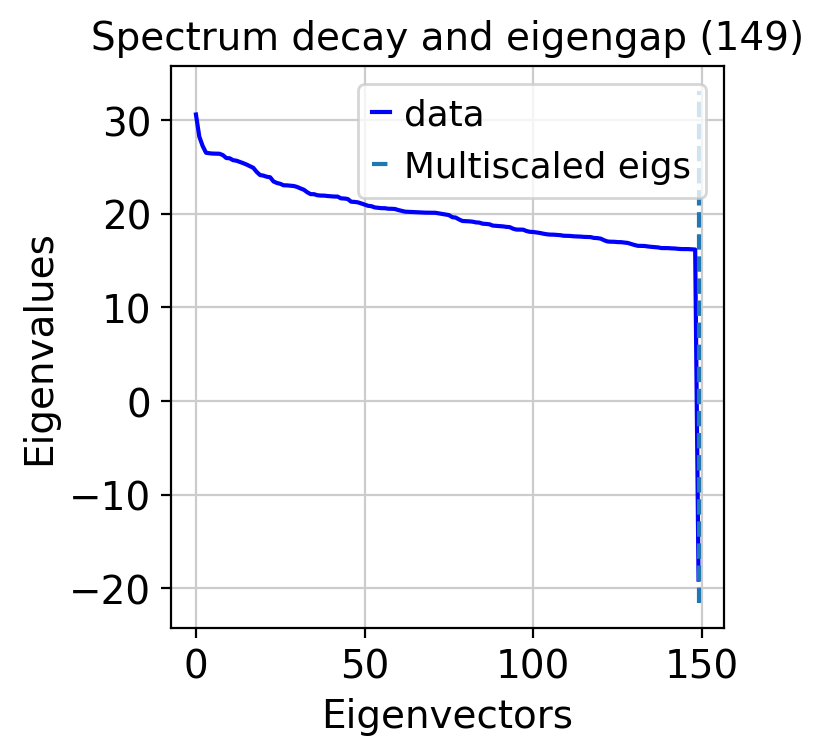

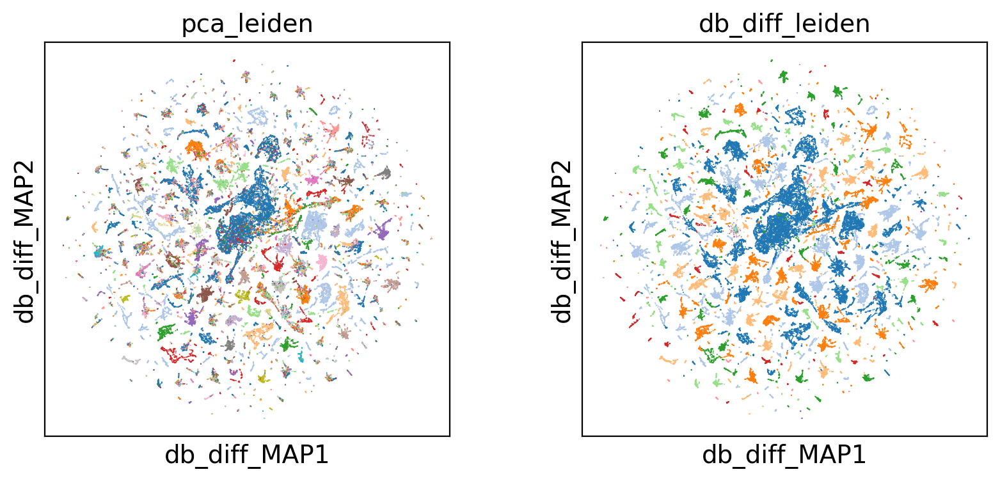

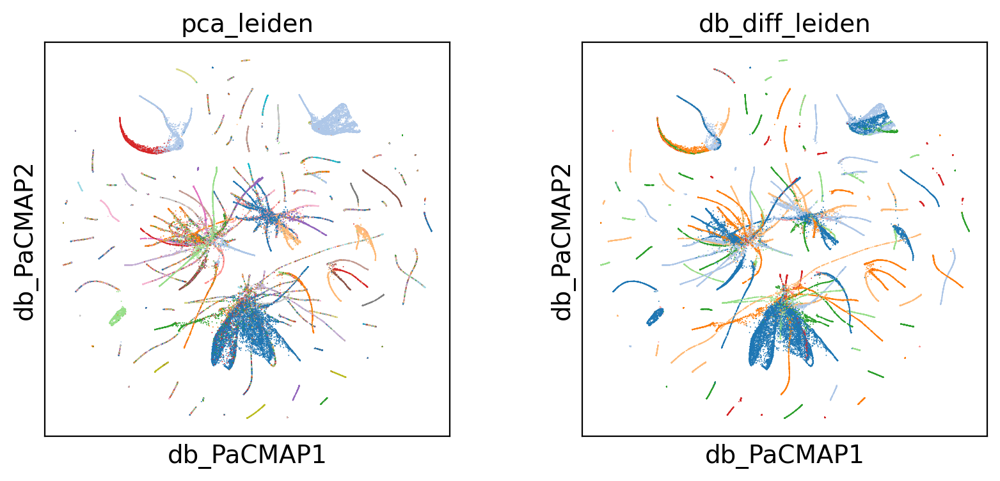

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


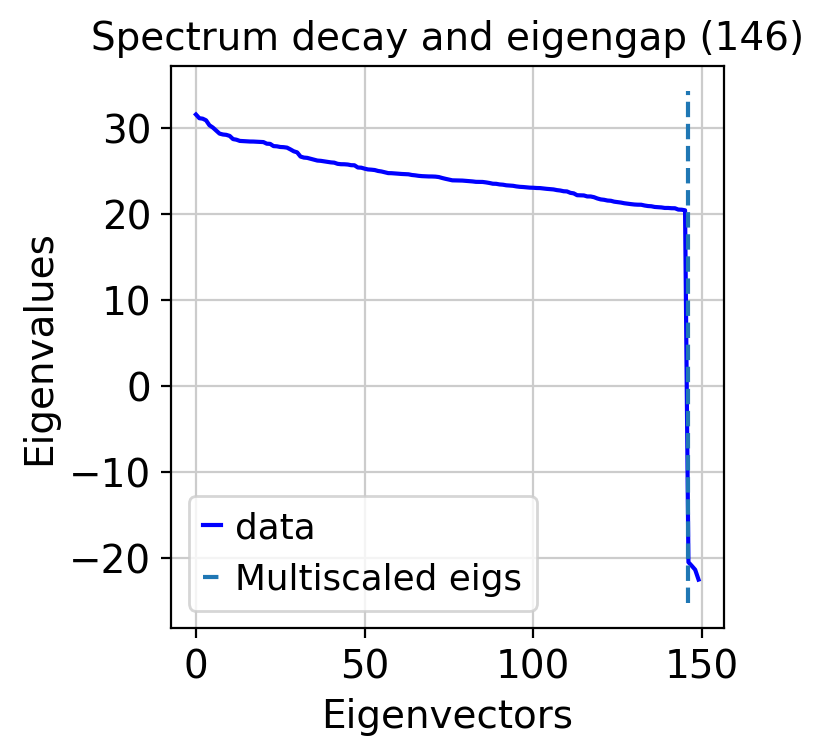

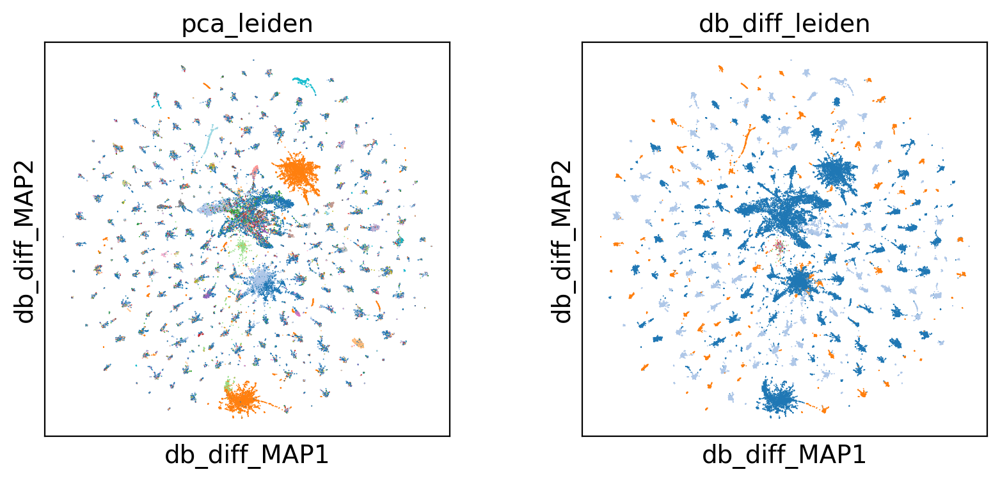

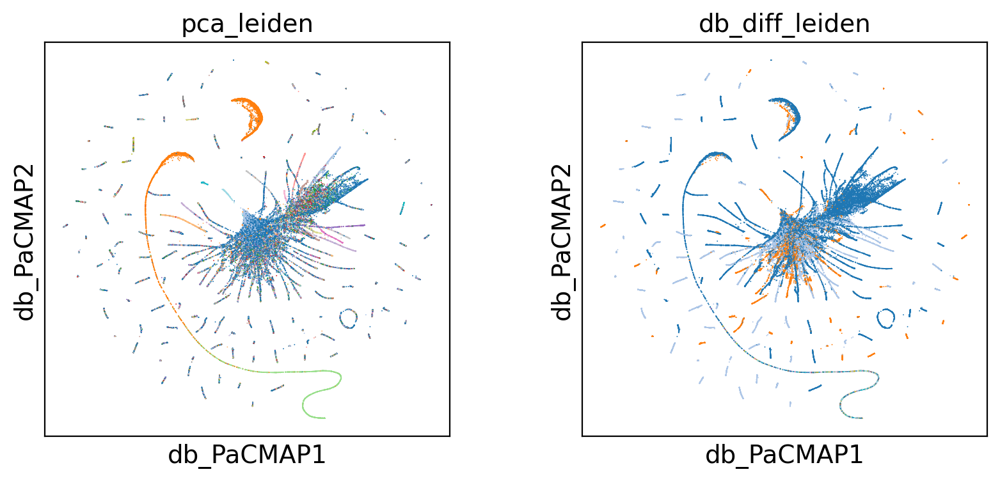

In [19]:
for adat in adatas_sc:
    tg = ct.TopOGraph(n_jobs=12, n_eigs=150, verbosity=0)
    adat = ct.topological_workflow(adat, tg, bases=['diffusion'], 
                                graphs=['diff'],                      
                                layouts=['MAP', 'PaCMAP'])
    tg.eigenspectrum()
    sc.pl.embedding(adat, basis='db_diff_MAP', color=['pca_leiden', 'db_diff_leiden'], palette='tab20', legend_loc=None)
    sc.pl.embedding(adat, basis='db_PaCMAP', color=['pca_leiden', 'db_diff_leiden'], palette='tab20', legend_loc=None)
    

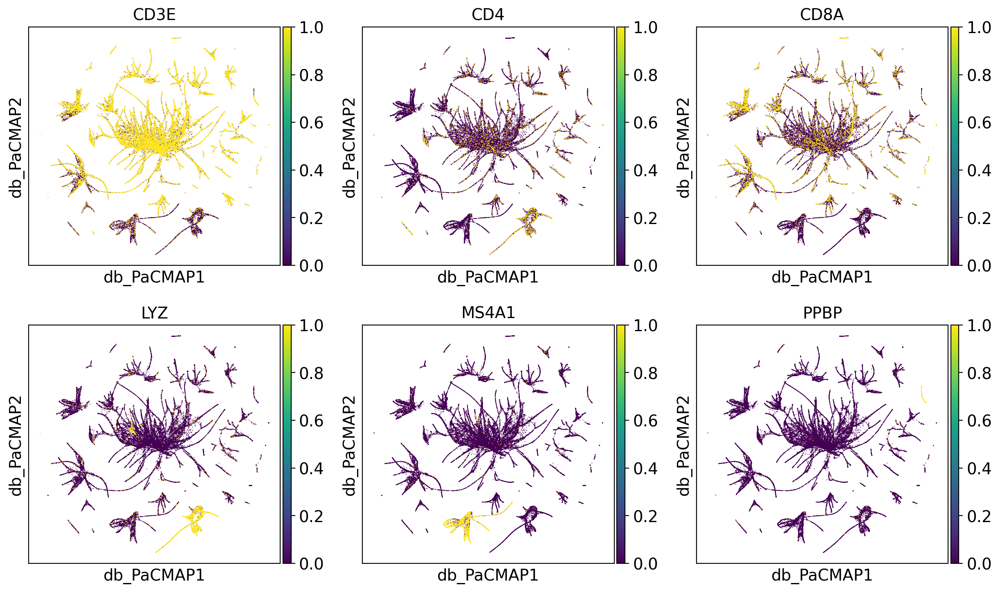

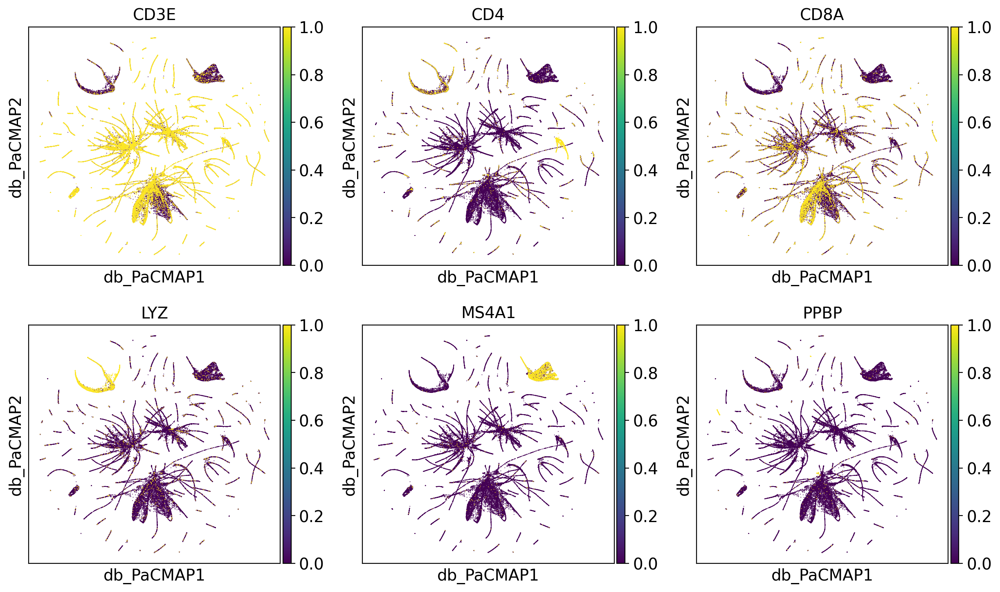

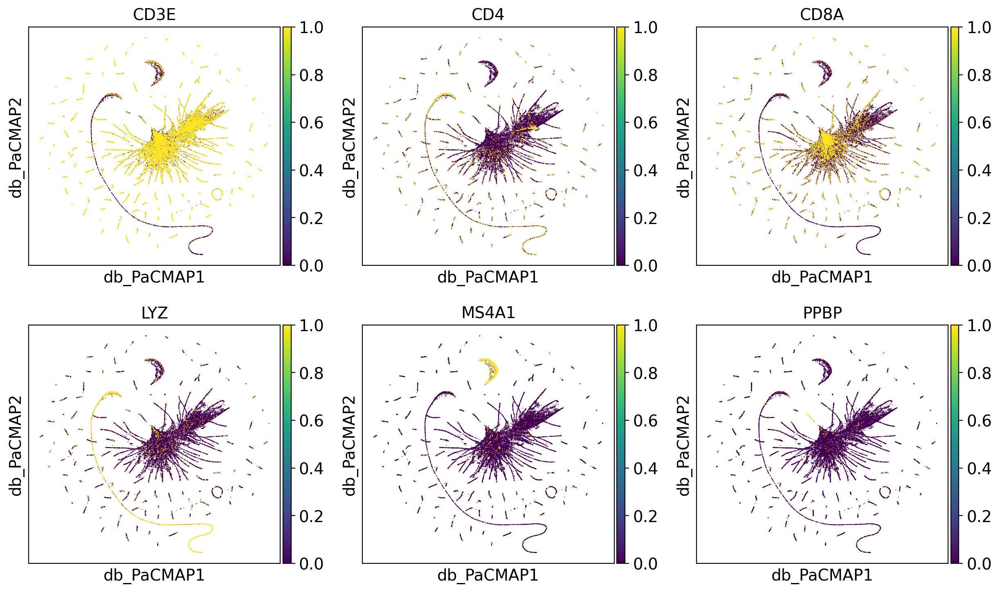

In [20]:
for adat in adatas_sc:
    sc.pl.embedding(adat, basis='db_PaCMAP', color=['CD3E', 'CD4', 'CD8A', 'LYZ', 'MS4A1', 'PPBP'], vmin=0, vmax=1, palette='tab20', legend_loc=None, ncols=3)

### Use Pearson residuals for normalization

In [21]:
def plot_hvg_pearson(adata):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    for ax in axes:
        hvgs = adata.var["highly_variable"]

        ax.scatter(
            adata.var["mean_counts"], adata.var["residual_variances"], s=3, edgecolor="none"
        )
        ax.scatter(
            adata.var["mean_counts"][hvgs],
            adata.var["residual_variances"][hvgs],
            c="tab:red",
            label="selected genes",
            s=3,
            edgecolor="none",
        )
        ax.set_xscale("log")
        ax.set_xlabel("mean expression")
        ax.set_yscale("log")
        ax.set_ylabel("residual variance")

        ax.spines["right"].set_visible(False)
        ax.spines["top"].set_visible(False)
        ax.yaxis.set_ticks_position("left")
        ax.xaxis.set_ticks_position("bottom")
    plt.legend()

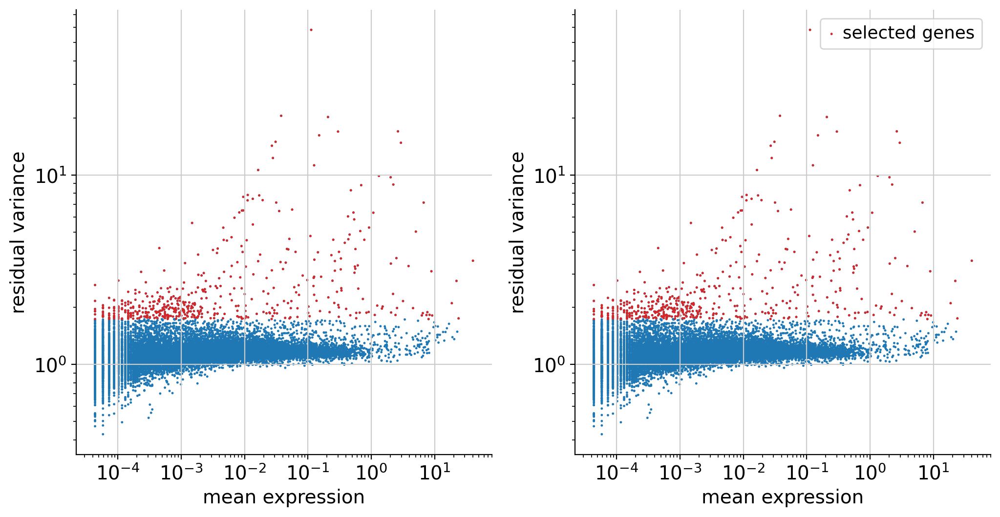

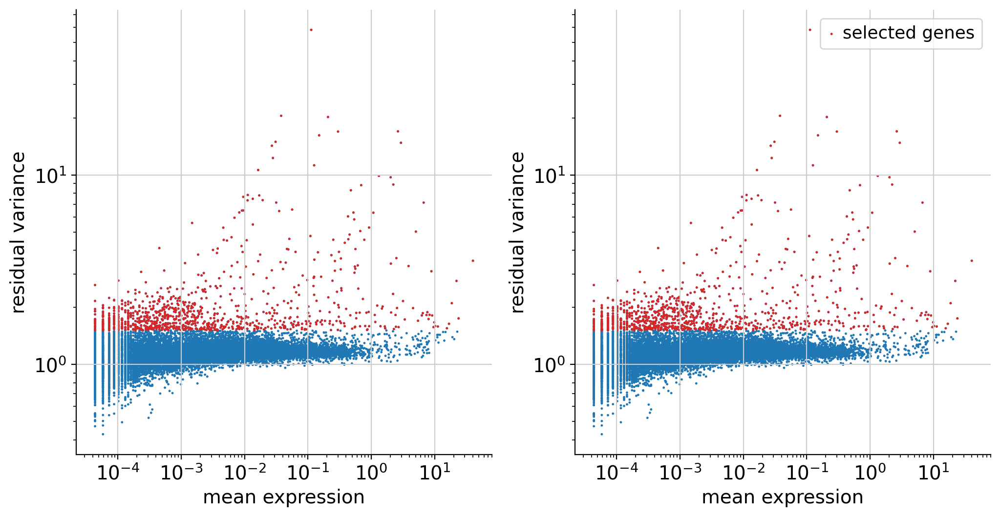

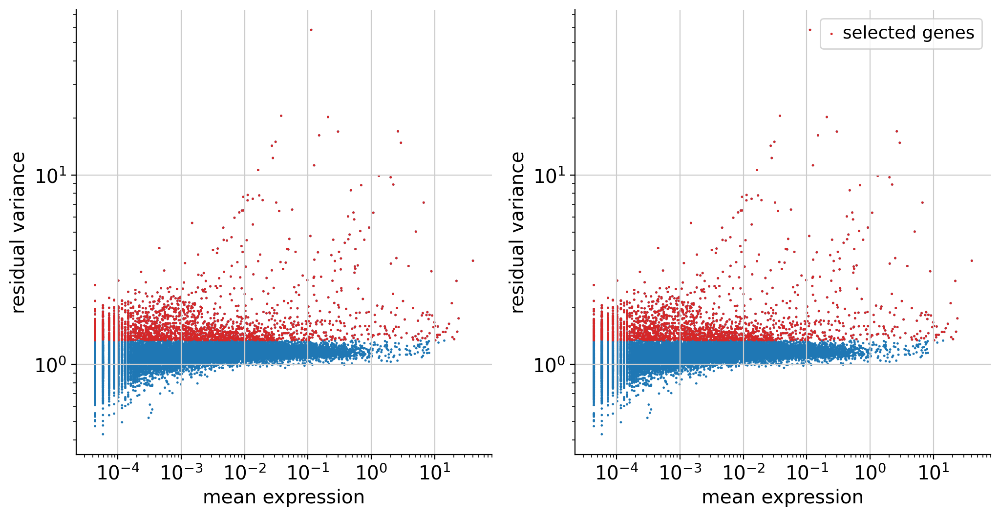

In [22]:
adata_pearson_500 = adata_raw.copy()
adata_pearson_1k = adata_raw.copy()
adata_pearson_2k = adata_raw.copy()

adatas_pearson_genes = [(adata_pearson_500, 500), (adata_pearson_1k, 1000), (adata_pearson_2k, 2000)]
adatas_pearson = []

for adat, n_genes in adatas_pearson_genes:
    sc.experimental.pp.highly_variable_genes(adat, flavor="pearson_residuals", n_top_genes=n_genes)
    plot_hvg_pearson(adat)
    adat.raw = adat
    adat = adat[:, adat.var["highly_variable"]]
    adat.layers["raw"] = adat.X.copy()
    adat.layers["sqrt_norm"] = np.sqrt(
    sc.pp.normalize_total(adat, inplace=False)["X"])
    sc.experimental.pp.normalize_pearson_residuals(adat)
    adatas_pearson.append(adat)

In [23]:
adatas_pearson

[AnnData object with n_obs × n_vars = 66834 × 500
     obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
     var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
     uns: 'hvg', 'pearson_residuals_normalization'
     layers: 'raw', 'sqrt_norm',
 AnnData object with n_obs × n_vars = 66834 × 1000
     obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
     var: 'gene_ids', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
     uns: 'hvg', 'pearson_residuals_normalization'
     layers: 'raw', 'sqrt_norm',
 AnnData object with n_obs × n_vars = 66834 × 2000
     obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_m

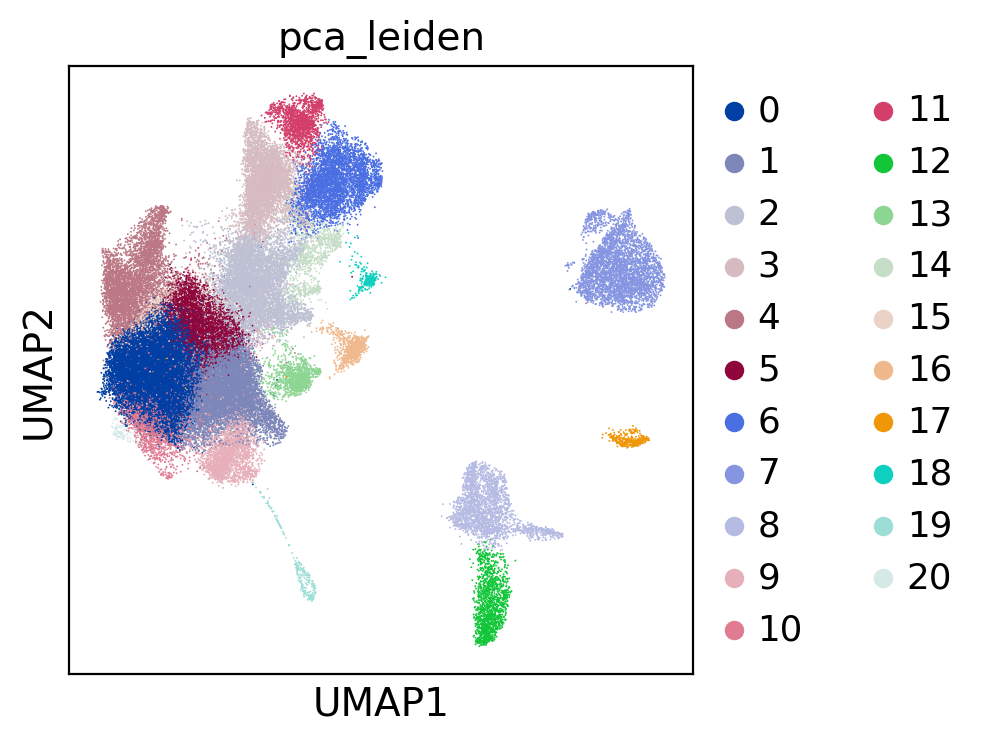

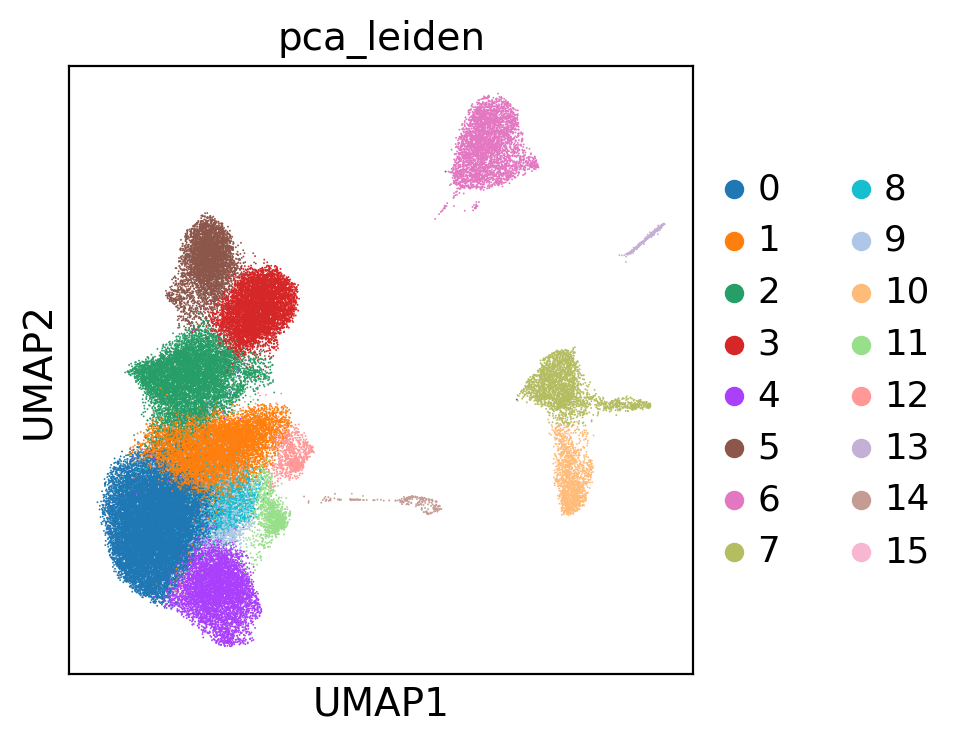

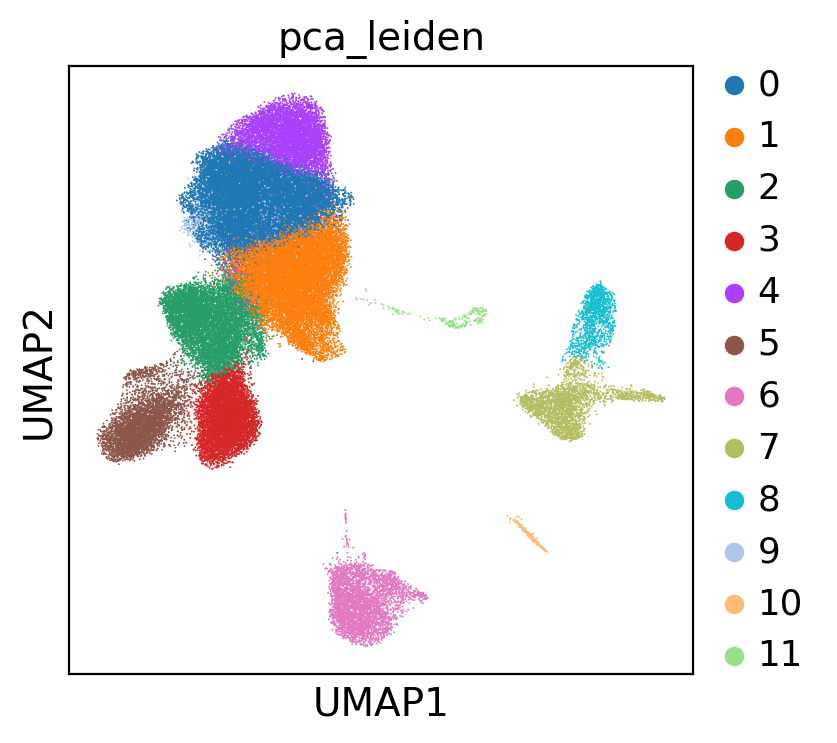

In [24]:
for adat in adatas_pearson:
    adat = ct.default_workflow(adat)
    sc.pl.umap(adat, color='pca_leiden')

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


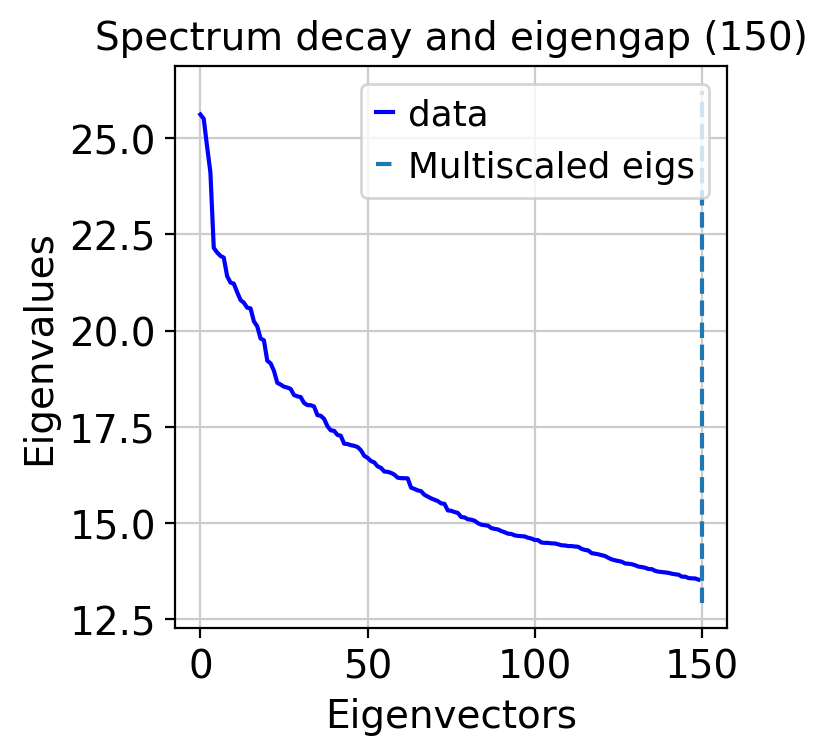

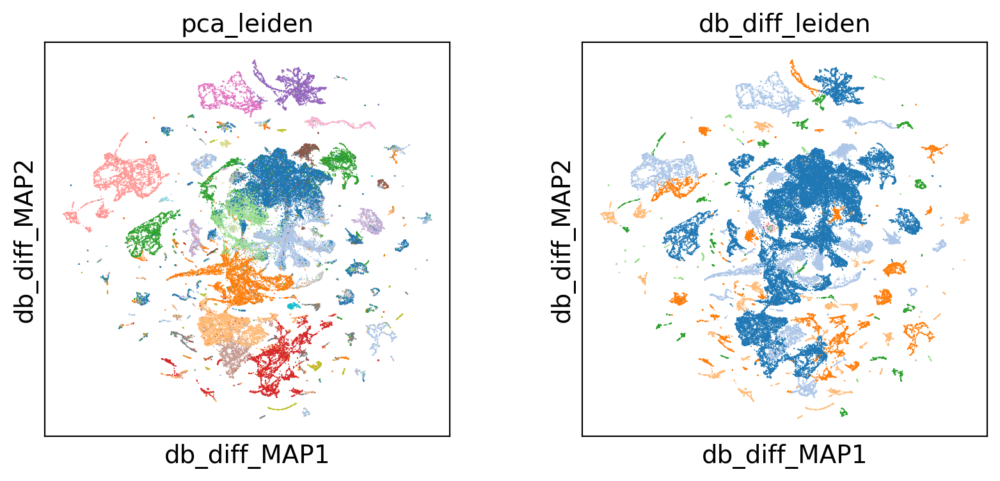

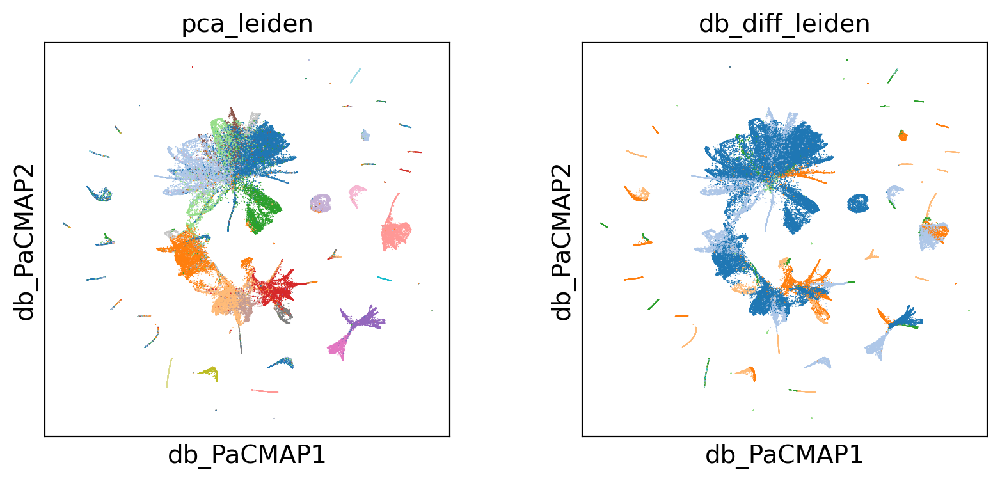

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


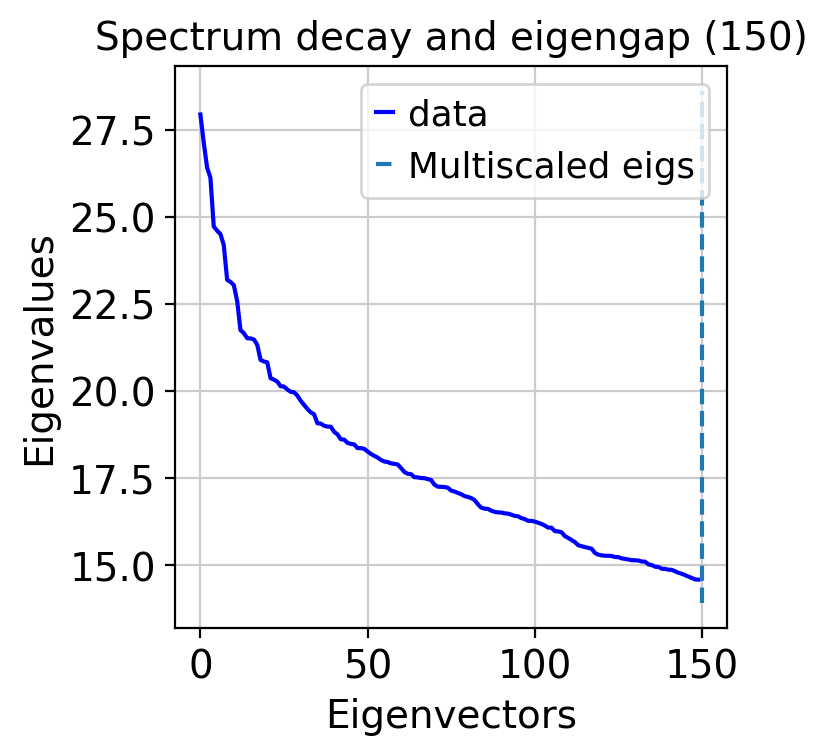

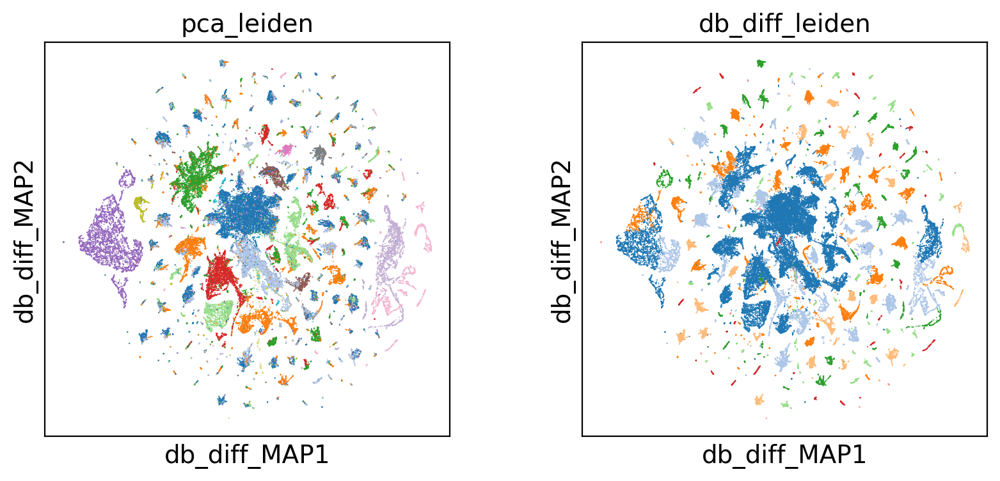

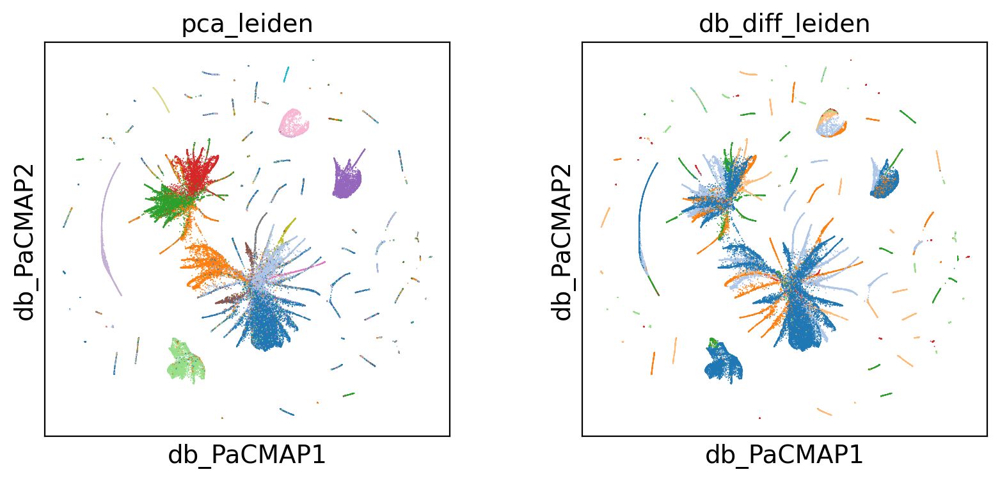

/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:383: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if Yinit is None or Yinit == "pca":
/home/davi/.local/lib/python3.9/site-packages/pacmap/pacmap.py:389: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif Yinit == "random":


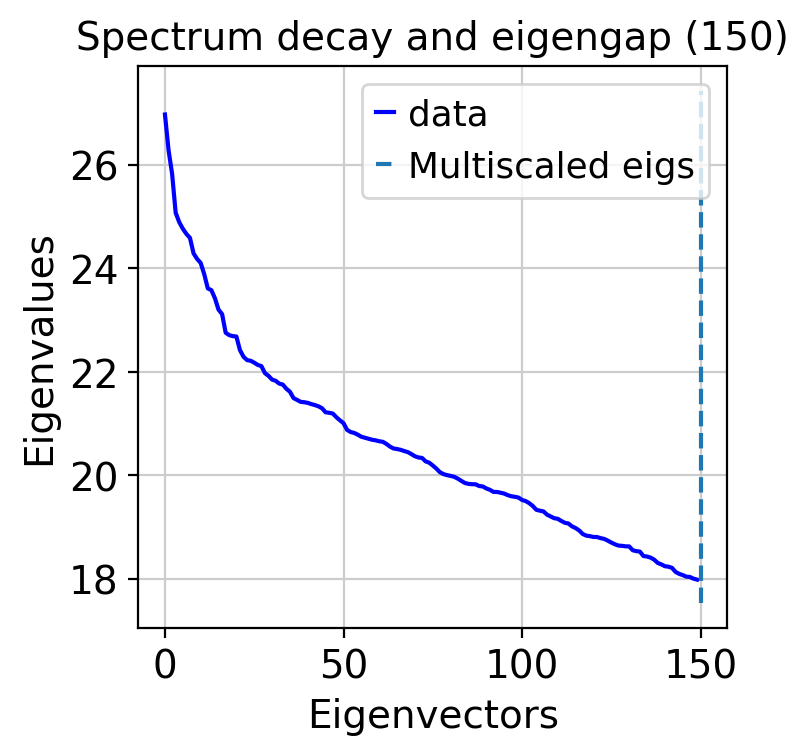

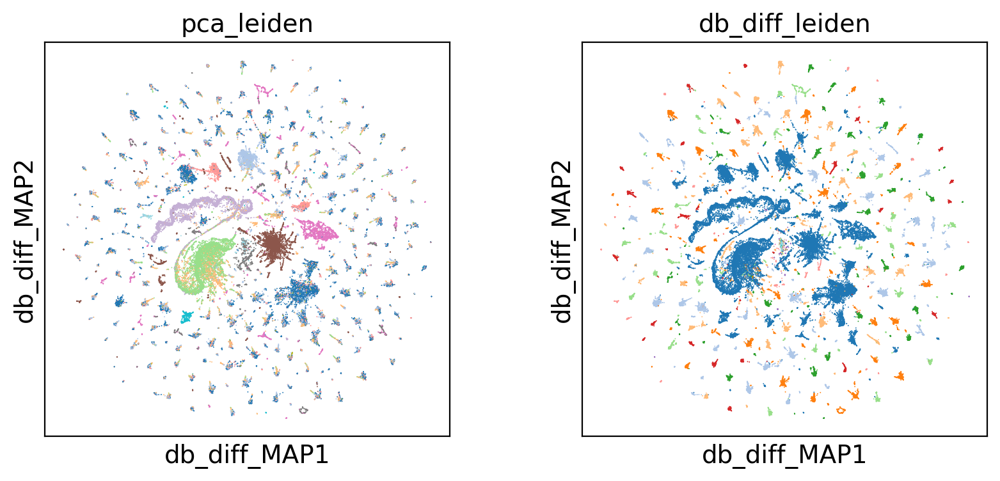

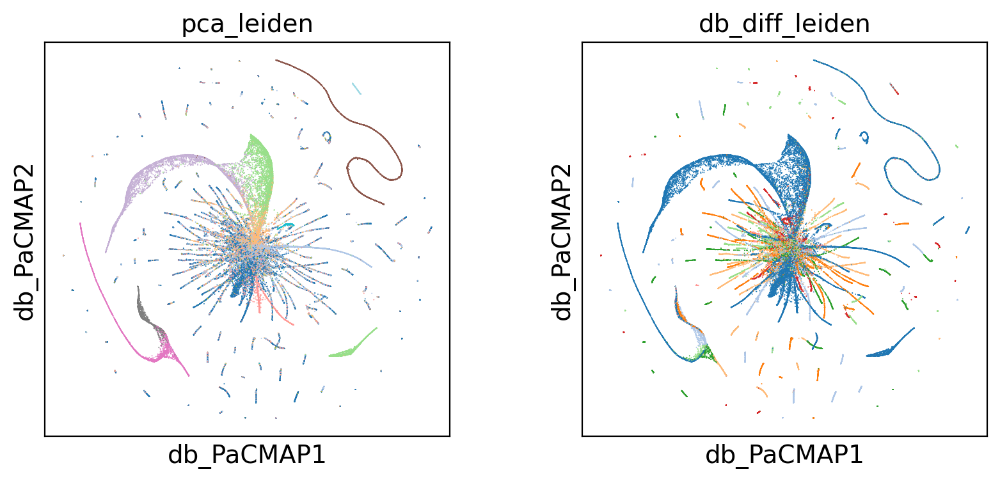

In [25]:
for adat in adatas_pearson:
    tg = ct.TopOGraph(n_jobs=12, n_eigs=150, verbosity=0)
    adat = ct.topological_workflow(adat, tg, bases=['diffusion'], 
                                graphs=['diff'],                      
                                layouts=['MAP', 'PaCMAP'])
    tg.eigenspectrum()
    sc.pl.embedding(adat, basis='db_diff_MAP', color=['pca_leiden', 'db_diff_leiden'], palette='tab20', legend_loc=None)
    sc.pl.embedding(adat, basis='db_PaCMAP', color=['pca_leiden', 'db_diff_leiden'], palette='tab20', legend_loc=None)
    

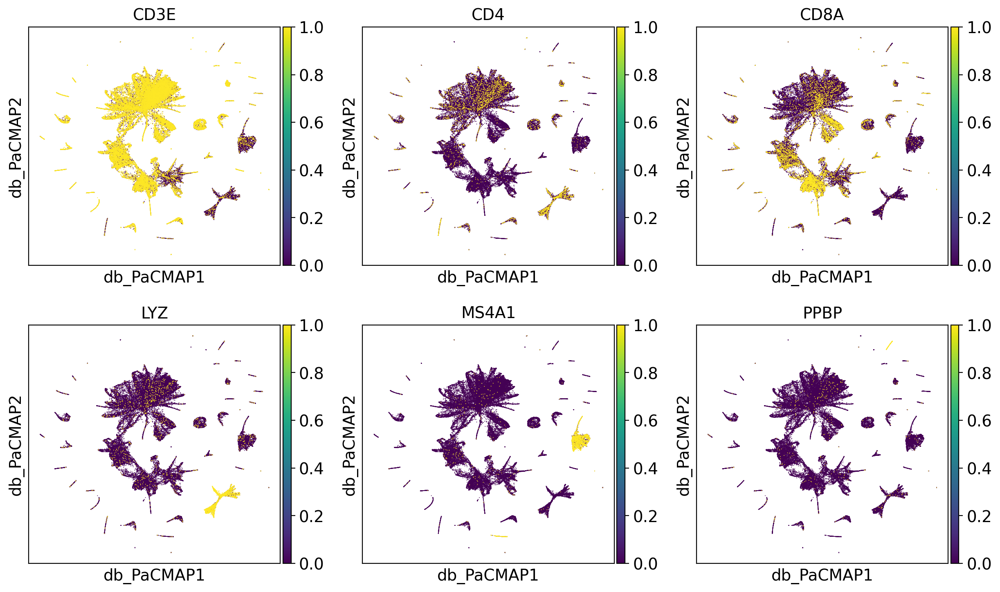

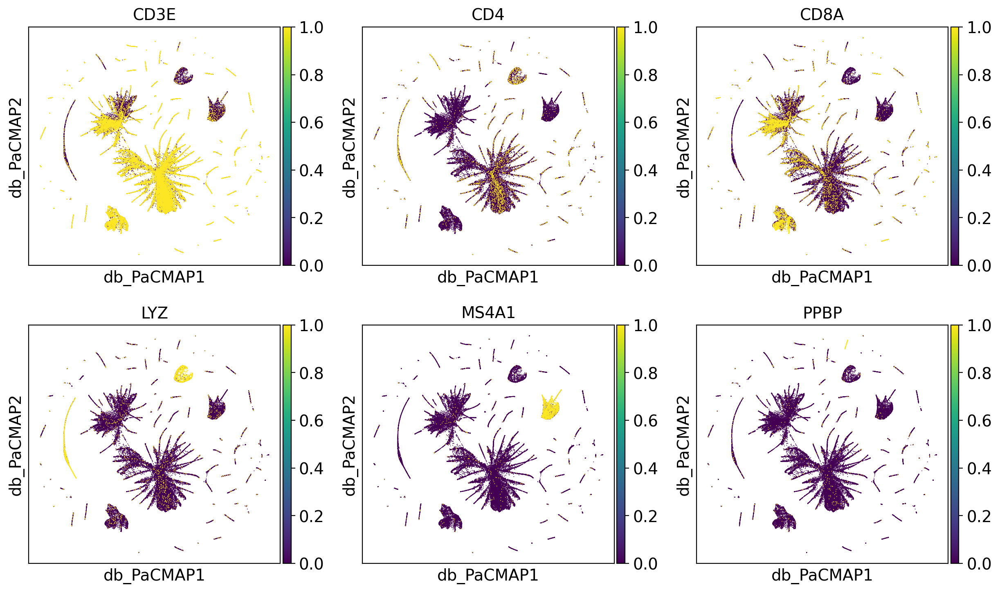

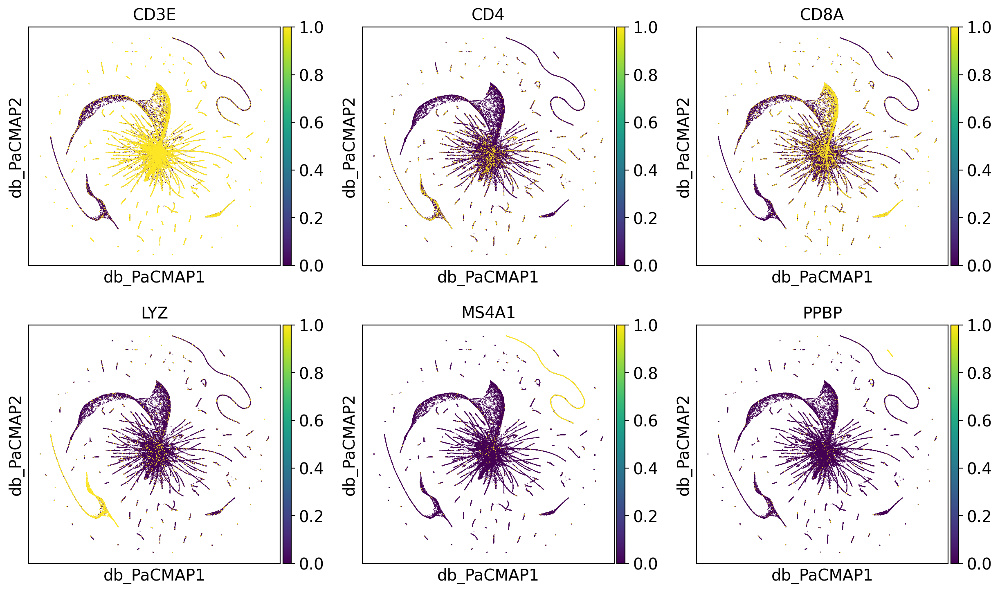

In [26]:
for adat in adatas_pearson:
    sc.pl.embedding(adat, basis='db_PaCMAP', color=['CD3E', 'CD4', 'CD8A', 'LYZ', 'MS4A1', 'PPBP'], vmin=0, vmax=1, palette='tab20', legend_loc=None, ncols=3)